In [1]:
import pandas as pd
import numpy as np
import math
import re
import requests
import shopify
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.dates as mdates
import xgboost as xgb
import pickle
#import pandas_profiling as pp #CHECK WHAT IS REQUIRED!

from operator import attrgetter
from datetime import datetime

from matplotlib.dates import DateFormatter
from sklearn.metrics import mean_squared_error
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import TimeSeriesSplit
from sklearn.linear_model import ElasticNet
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import VotingRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score
from xgboost import plot_importance

import warnings
warnings.filterwarnings('ignore')


In [2]:
pd.set_option('display.max_rows', 50)
pd.set_option('display.max_columns', 50)
pd.set_option('display.width', 1000)

In [3]:
plt.style.use('dark_background')

# **SHOPIFY DATA ACQUISITION**

In [4]:
hostname = 'see-theunseen.myshopify.com'
version = '2022-01'

In [ ]:
api_key = pd.read_csv('api_key.csv')
api_key = pd.DataFrame(api_key)

In [ ]:
apikey = api_key['apikey']
password = api_key['password']

In [5]:
#GET CUSTOMERS DATABASE

resource = 'customers'

def get_all_customers():
    last=0
    customers=pd.DataFrame()
    while True:
        url = f"https://{apikey}:{password}@{hostname}/admin/api/{version}/{resource}.json?limit=250&status=any&since_id={last}"
        response = requests.request("GET", url)       
        df=pd.DataFrame(response.json()['customers'])
        customers=pd.concat([customers,df])
        last=df['id'].iloc[-1]
        if len(df)<250:
            break
    return(customers)
df0=get_all_customers()
df=df0

In [6]:
df['total_spent'] = df['total_spent'].astype('float')
df['orders_count'] = df['orders_count'].astype('int')
df['email'] = df['email'].astype('str')
df['email'] = df['email'].str.lower()

In [7]:
#ADD LOCATION TO CUSTOMERS DATA BASE 

city_app = pd.DataFrame()
for i in range(len(df)):
    
    address_aux = df.iloc[i].loc['addresses']
    address_aux = pd.DataFrame(address_aux)

    a1 = address_aux.size

    if a1 >1:
        last_address = address_aux.iloc[len(address_aux)-1]
        last_address = pd.DataFrame(last_address).T
        last_address
        city_app = city_app.append(last_address[['city','country', 'first_name']],i)
    else:
        city_aux2 = {'city': ['No entry'],'country': ['No entry'],'first_name': ['No entry']}  #ADD 'no entry' TO NONE/ NULL CELLS FOR CUSTOMERS THAT DIDN'T ADD ADDRESS
        city_aux2 = pd.DataFrame(city_aux2)
        city_app = city_app.append(city_aux2[['city','country', 'first_name']],i)

In [8]:
city_app['email'] = list(df['email'])
city_app['orders_count'] = list(df['orders_count'])
city_app['total_spent'] = list(df['total_spent'])
df2 = city_app 
df2

,city,country,first_name,email,orders_count,total_spent
0,No entry,No entry,No entry,glen@stackupdigital.co.uk,0,0.00
1,No entry,No entry,No entry,jamie@stackupdigital.co.uk,1,75.00
2,City,United Kingdom,Terry,jack@stackupdigital.co.uk,1,0.00
3,London,United Kingdom,Richard,ric_oliver@hotmail.co.uk,0,0.00
4,London,United Kingdom,Talia,t.danielleklein@gmail.com,1,35.99
...,...,...,...,...,...,...
2647,Wellingborough,United Kingdom,Svetlana,svetlinka.md@gmail.com,1,68.99
2648,Pittsburgh,United States,Alysha,ajlieurance@gmail.com,1,74.03
2649,Pawcatuck,United States,Mat,briggs.matt22@gmail.com,0,0.00
2650,Louisville,United States,Kelly,kellyraecasper@hotmail.com,1,74.03


In [9]:
# GET ORDERS DATA BASE

resource = 'orders'

def get_all_orders():
    last=0
    orders=pd.DataFrame()
    while True:
        url = f"https://{apikey}:{password}@{hostname}/admin/api/{version}/{resource}.json?limit=250&status=any&since_id={last}"
        response = requests.request("GET", url)       
        df=pd.DataFrame(response.json()['orders'])
        orders=pd.concat([orders,df])
        last=df['id'].iloc[-1]
        if len(df)<250:
            break
    return(orders)
df=get_all_orders()
df.head(5)

,id,admin_graphql_api_id,app_id,browser_ip,buyer_accepts_marketing,cancel_reason,cancelled_at,cart_token,checkout_id,checkout_token,closed_at,confirmed,contact_email,created_at,currency,current_subtotal_price,current_subtotal_price_set,current_total_discounts,current_total_discounts_set,current_total_duties_set,current_total_price,current_total_price_set,current_total_tax,current_total_tax_set,customer_locale,...,total_discounts_set,total_line_items_price,total_line_items_price_set,total_outstanding,total_price,total_price_set,total_price_usd,total_shipping_price_set,total_tax,total_tax_set,total_tip_received,total_weight,updated_at,user_id,customer,discount_applications,fulfillments,line_items,payment_terms,refunds,shipping_lines,client_details,billing_address,payment_details,shipping_address
0,2855730446501,gid://shopify/Order/2855730446501,1354745,None,False,None,None,None,NaN,None,None,True,jamie@stackupdigital.co.uk,2020-11-16T13:31:26+00:00,GBP,75.00,"{'shop_money': {'amount': '75.00', 'currency_c...",0.00,"{'shop_money': {'amount': '0.00', 'currency_co...",None,75.00,"{'shop_money': {'amount': '75.00', 'currency_c...",0.00,"{'shop_money': {'amount': '0.00', 'currency_co...",en,...,"{'shop_money': {'amount': '0.00', 'currency_co...",75.00,"{'shop_money': {'amount': '75.00', 'currency_c...",0.00,75.00,"{'shop_money': {'amount': '75.00', 'currency_c...",99.16,"{'shop_money': {'amount': '0.00', 'currency_co...",0.00,"{'shop_money': {'amount': '0.00', 'currency_co...",0.00,0,2020-11-16T13:31:27+00:00,6.236733e+10,"{'id': 4188337668261, 'email': 'jamie@stackupd...",[],[],"[{'id': 6198253093029, 'admin_graphql_api_id':...",None,[],[],NaN,NaN,NaN,NaN
1,2999722049701,gid://shopify/Order/2999722049701,580111,82.3.107.37,False,None,None,f19593d7e077ce89132d3ffe431dc6d8,1.825161e+13,790993afbbd3db1364b75463af182c15,None,True,jack@stackupdigital.co.uk,2021-01-19T09:01:27+00:00,GBP,175.00,"{'shop_money': {'amount': '175.00', 'currency_...",0.00,"{'shop_money': {'amount': '0.00', 'currency_co...",None,175.00,"{'shop_money': {'amount': '175.00', 'currency_...",0.00,"{'shop_money': {'amount': '0.00', 'currency_co...",en,...,"{'shop_money': {'amount': '0.00', 'currency_co...",175.00,"{'shop_money': {'amount': '175.00', 'currency_...",0.00,175.00,"{'shop_money': {'amount': '175.00', 'currency_...",237.55,"{'shop_money': {'amount': '0.00', 'currency_co...",0.00,"{'shop_money': {'amount': '0.00', 'currency_co...",0.00,0,2021-01-19T09:01:29+00:00,NaN,"{'id': 4286884774053, 'email': 'jack@stackupdi...",[],[],"[{'id': 6456382161061, 'admin_graphql_api_id':...",None,[],"[{'id': 2460109275301, 'carrier_identifier': N...","{'accept_language': 'en-GB,en-US;q=0.9,en;q=0....","{'first_name': 'Terry', 'address1': 'Line ', '...","{'credit_card_bin': '424242', 'avs_result_code...","{'first_name': 'Terry', 'address1': 'Line ', '..."
2,4157167206565,gid://shopify/Order/4157167206565,580111,81.145.228.90,False,None,None,be6b1b9bff6aae78a8feb623e9b0271e,2.517712e+13,5dceab9ee22d9bcb3843f03414144508,None,True,t.danielleklein@gmail.com,2021-10-18T10:57:54+01:00,GBP,33.00,"{'shop_money': {'amount': '33.00', 'currency_c...",0.00,"{'shop_money': {'amount': '0.00', 'currency_co...",None,35.99,"{'shop_money': {'amount': '35.99', 'currency_c...",0.00,"{'shop_money': {'amount': '0.00', 'currency_co...",en,...,"{'shop_money': {'amount': '0.00', 'currency_co...",33.00,"{'shop_money': {'amount': '33.00', 'currency_c...",0.00,35.99,"{'shop_money': {'amount': '35.99', 'currency_c...",49.38,"{'shop_money': {'amount': '2.99', 'currency_co...",0.00,"{'shop_money': {'amount': '0.00', 'currency_co...",0.00,20,2021-12-14T17:20:03+00:00,NaN,"{'id': 5626455752869, 'email': 't.danielleklei...",[],"[{'id': 3707180449957, 'admin_graphql_api_id':...","[{'id': 10571503960229, 'admin_graphql_api_id'...",None,[],"[{'id': 3504104177829, 'carrier_identifier': N...","{'accept_language': 'en-GB,en;q=0.9,en-US;q=0....","{'first_name': 'Talia', 'address1': '6 St Owen...","{'credit_card_bin'

In [10]:
test = pd.DataFrame(df['line_items'])
x9 = pd.DataFrame()
x4 = pd.DataFrame()
#     i=4
for i in range(len(test)):
    
    x8 = pd.DataFrame(columns = ['Spectra410', 'Spectra808','CA_scarab', 'CA_borealis', 'CA_peacock', 'CA_phoenix', 'CA_andrite'])
    x1 = test['line_items'].iloc[i]
    x2 = pd.DataFrame(x1)
    variants_file = np.array(x2['variant_title'].iloc[:], dtype='str')
    variants_units = x2['quantity']
    x3 = pd.DataFrame(variants_file).T
    x5 = pd.DataFrame(variants_units).T
    x7 = pd.concat([x3,x5], axis=0)
    x7.columns = list(x7.iloc[0])
    x7.drop(x7.index[0],inplace=True) 
    x7 = x7.groupby(by=x7.columns, axis=1).sum()
    x7 = x7.reset_index()
    del x7['index']
    
    a0 = {'4.10 𝚫'}.issubset(x7.columns)
    if a0 == True:
        x8['Spectra410'] = [x7['4.10 𝚫'].iloc[0]]
        #print(i)
    a1 = {'8.08 𝚫'}.issubset(x7.columns)
    if a1 == True:
        x8['Spectra808'] = [x7['8.08 𝚫'].iloc[0]]
    
    a2 = {'Borealis'}.issubset(x7.columns)
    if a2 == True:
        x8['CA_borealis'] = [x7['Borealis'].iloc[0]]
    
    a3 = {'Peacock'}.issubset(x7.columns)
    if a3 == True:   
        x8['CA_peacock'] = [x7['Peacock'].iloc[0]]

    a4 = {'Scarab'}.issubset(x7.columns)
    if a4 == True:
        x8['CA_scarab'] = [x7['Scarab'].iloc[0]]
    
    a5 = {'Phoenix'}.issubset(x7.columns)
    if a5 == True:
        x8['CA_phoenix'] = [x7['Phoenix'].iloc[0]]

    a6 = {'Andrite'}.issubset(x7.columns)
    if a6 == True:
        x8['CA_andrite'] = [x7['Andrite'].iloc[0]]
    #    
    x9=x9.append(x8,i)
    


In [11]:
x9 = x9.fillna(0)

In [12]:
x9.insert(0,'email',list(df['contact_email'].str.lower()))
order_created = df['created_at']
order_created = list((df['created_at']))
x9.insert(0, 'Date', order_created)

In [13]:
df2.groupby(['email']).head().sort_values(by = 'total_spent',ascending = False).head(20)
df_city_spent = df2[['city', 'country', 'total_spent']]
df_city_spent.to_csv('spent_by_city.csv')

In [14]:
x5 = pd.DataFrame()
x6 = pd.DataFrame()

for i in range(len(df2)):
    g = pd.DataFrame()
    email_1 = df2['email'].iloc[i]
    order_count_1 = df2['orders_count'].iloc[i]

    if order_count_1 > 0:
        email_map = pd.Series(x9['email'].str.contains(email_1, na=False)) 
        g['Spectra410'] = x9[email_map]['Spectra410']
        g['Spectra808'] = x9[email_map]['Spectra808']
        g['CA_scarab'] = x9[email_map]['CA_scarab']
        g['CA_borealis'] = x9[email_map]['CA_borealis']
        g['CA_peacock'] = x9[email_map]['CA_peacock']
        g['CA_phoenix'] = x9[email_map]['CA_phoenix']
        g['CA_andrite'] = x9[email_map]['CA_andrite']
       
        x6 = pd.DataFrame(g.sum())
        x5 = x5.append(x6.T,i)  
    elif order_count_1 == 0:
        g['Spectra410'] = 0
        g['Spectra808'] = 0
        g['CA_scarab'] = 0
        g['CA_borealis'] = 0
        g['CA_peacock'] = 0
        g['CA_phoenix'] = 0
        g['CA_andrite'] = 0        
        x6 = pd.DataFrame(g.sum())
        x5 = x5.append(x6.T,i)        


In [15]:
df2.insert(6,'Spectra410',x5['Spectra410'])
df2.insert(7,'Spectra808',x5['Spectra808'])
df2.insert(8,'CA_scarab',x5['CA_scarab'])
df2.insert(9,'CA_borealis',x5['CA_borealis'])
df2.insert(10,'CA_peacock',x5['CA_peacock'])
df2.insert(11,'CA_phoenix',x5['CA_phoenix'])
df2.insert(12,'CA_andrite',x5['CA_andrite'])

In [16]:
df3 = df2[['email','orders_count','total_spent','Spectra410','Spectra808','CA_scarab','CA_borealis','CA_peacock','CA_phoenix','CA_andrite']]

In [17]:
df5_allc = df3.groupby(['email']).head().sort_values(by='orders_count', ascending = False).sum()
df5_20c = df3.groupby(['email']).head().sort_values(by='orders_count', ascending = False).head(20).sum()


In [18]:
df6_allc = df3.groupby(['email']).head().sort_values(by='total_spent', ascending = False).sum()
df6_20c = df3.groupby(['email']).head().sort_values(by='total_spent', ascending = False).head(20).sum()


In [19]:
df5_allc = pd.DataFrame(df5_allc)
df5_allc.columns = ['prod_dist']
df5_allc=df5_allc.T
df5_allc = df5_allc[['Spectra410', 'Spectra808','CA_scarab', 'CA_borealis', 'CA_peacock', 'CA_phoenix', 'CA_andrite']]

df5_20c = pd.DataFrame(df5_20c)
df5_20c.columns = ['prod_dist']
df5_20c=df5_20c.T
df5_20c = df5_20c[['Spectra410', 'Spectra808','CA_scarab', 'CA_borealis', 'CA_peacock', 'CA_phoenix', 'CA_andrite']]

In [20]:
df6_20c = pd.DataFrame(df6_20c)
df6_20c.columns = ['prod_dist']
df6_20c=df6_20c.T
df6_20c = df6_20c[['Spectra410', 'Spectra808','CA_scarab', 'CA_borealis', 'CA_peacock', 'CA_phoenix', 'CA_andrite']]

In [21]:
Total_prod = df5_allc.loc['prod_dist'].sum()
df5_allc = df5_allc/Total_prod
df5_allc=df5_allc.T

Total_prod = df5_20c.loc['prod_dist'].sum()
df5_20c = df5_20c/Total_prod
df5_20c=df5_20c.T
Total_prod2 = df6_20c.loc['prod_dist'].sum()
df6_20c = df6_20c/Total_prod
df6_20c=df6_20c.T

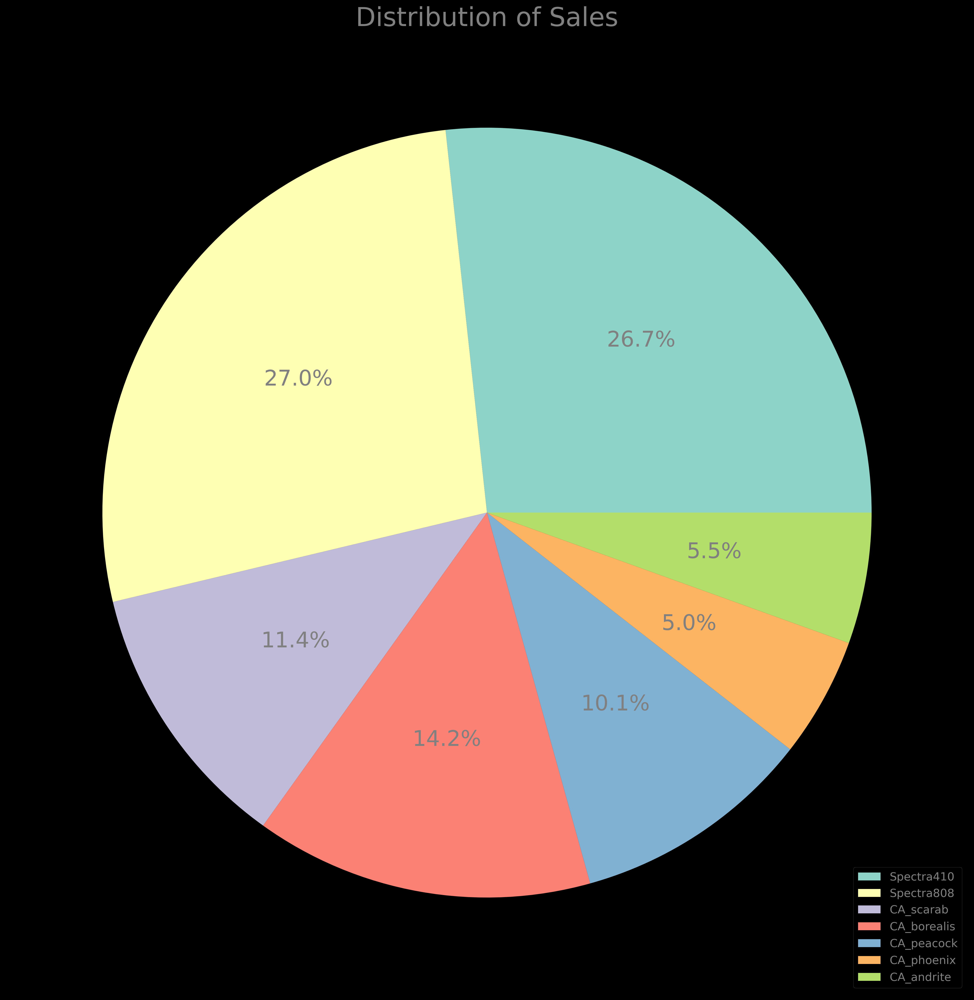

In [196]:
# plt.rcParams['figure.figsize'] = [20, 5]
fig = plt.figure(dpi=300)
plt.rcParams['patch.linewidth'] = 0.1
plt.rcParams["text.color"] = 'grey'
plt.title(label='Distribution of Sales',color='grey', size=30 )
plt.pie(df5_allc['prod_dist'],autopct='%0.1f%%', normalize = 'True')
plt.legend(labels = df5_allc.index,loc=4, fontsize = 13)
plt.show()

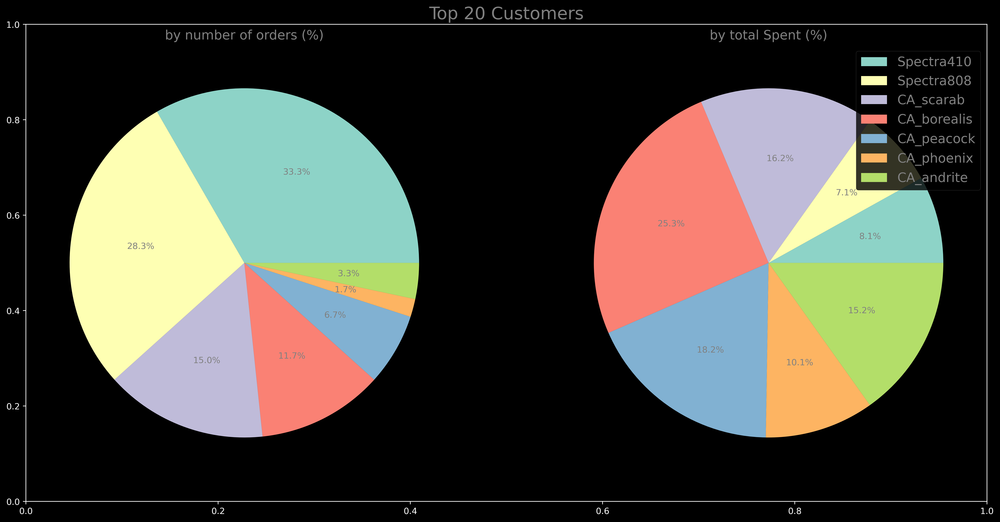

In [23]:

plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
plt.rcParams["text.color"] = 'grey'
plt.title(label='Top 20 Customers',color='grey', size=20 )
ax1 = fig.add_subplot(121)
ax1.pie(df5_20c['prod_dist'],autopct='%0.1f%%', normalize = 'True')
ax2 = fig.add_subplot(122)
ax2.pie(df6_20c['prod_dist'],autopct='%0.1f%%', normalize = 'True')
ax1.set_title('by number of orders (%)', fontsize = 15)
ax2.set_title('by total Spent (%)',fontsize = 15)
plt.legend(labels = df5_20c.index,loc=1, fontsize = 15)
plt.show()


In [24]:
date2 = pd.DataFrame()
for i in range(len(x9)):
    order_created = pd.to_datetime(x9['Date'].iloc[i])   
    date = datetime.strftime(order_created, "%Y-%m-%d")
    date2 = date2.append(pd.Series(date), ignore_index=True)

In [25]:
date2.columns = ['date2']

In [26]:
x9['Spectra410_cum'] = x9['Spectra410'].cumsum(axis = 0)
x9['Spectra808_cum'] = x9['Spectra808'].cumsum(axis = 0)
x9['CA_scarab_cum'] = x9['CA_scarab'].cumsum(axis = 0)
x9['CA_borealis_cum'] = x9['CA_borealis'].cumsum(axis = 0)
x9['CA_peacock_cum'] = x9['CA_peacock'].cumsum(axis = 0)
x9['CA_phoenix_cum'] = x9['CA_phoenix'].cumsum(axis = 0)
x9['CA_andrite_cum'] = x9['CA_andrite'].cumsum(axis = 0)

In [27]:
y1 = x9['Spectra410_cum'].replace(0, np.nan)
y2 = x9['Spectra808_cum'].replace(0, np.nan)
y3 = x9['CA_scarab_cum'].replace(0, np.nan)
y4 = x9['CA_borealis_cum'].replace(0, np.nan)
y5 = x9['CA_peacock_cum'].replace(0, np.nan)
y6 = x9['CA_phoenix_cum'].replace(0, np.nan)
y7 = x9['CA_andrite_cum'].replace(0, np.nan)
x = pd.DataFrame()
x9['Date2'] = date2
x=x9['Date2']
df_plot = pd.DataFrame()
df_plot['Date']=x
df_plot['Spectra410']=y1
df_plot['Spectra808']=y2
df_plot['CA_scarab']=y2
df_plot['CA_borealis']=y4
df_plot['CA_peacock']=y5
df_plot['CA_phoenix']=y6
df_plot['CA_andrite']=y7
df_plot.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1747 entries, 0 to 1746
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Date         1747 non-null   object 
 1   Spectra410   1745 non-null   float64
 2   Spectra808   1744 non-null   float64
 3   CA_scarab    1744 non-null   float64
 4   CA_borealis  1444 non-null   float64
 5   CA_peacock   1440 non-null   float64
 6   CA_phoenix   1429 non-null   float64
 7   CA_andrite   1447 non-null   float64
dtypes: float64(7), object(1)
memory usage: 109.3+ KB


In [28]:
df_plot['Date']=pd.to_datetime(df_plot['Date']) 

<Figure size 8000x4000 with 0 Axes>

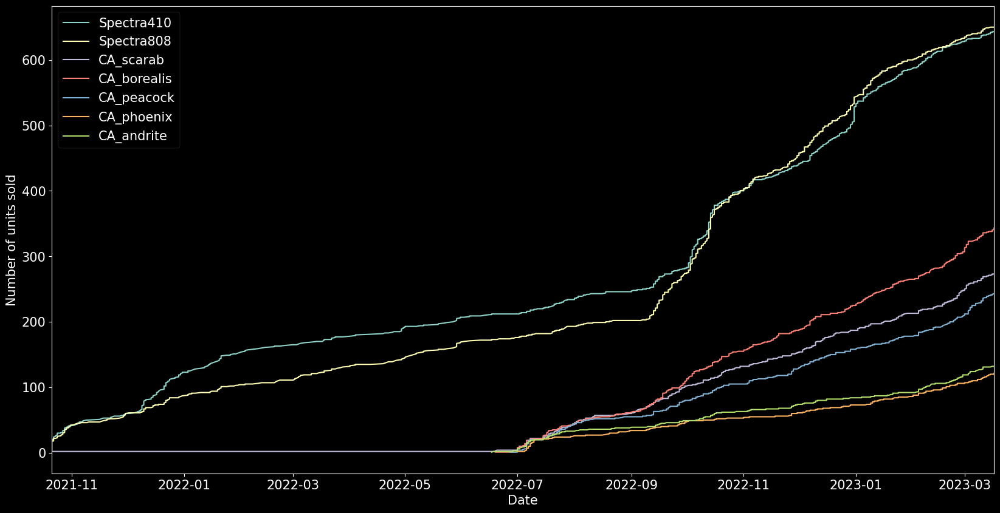

In [29]:
with plt.style.context('dark_background'):
    fig = plt.figure(dpi=400)
    plt.rcParams['figure.figsize'] = [20, 10]
    plt.rcParams["font.size"] = 10;
    fig, ax = plt.subplots()
    ax.plot(df_plot['Date'],y1)
    ax.plot(df_plot['Date'],y2)
    ax.plot(df_plot['Date'],y3)
    ax.plot(df_plot['Date'],y4)
    ax.plot(df_plot['Date'],y5)
    ax.plot(df_plot['Date'],y6)
    ax.plot(df_plot['Date'],y7)
    
    plt.rcParams['legend.fontsize'] = 15
    plt.rcParams["font.size"] = 15
    plt.rcParams["legend.frameon"] = 1
    plt.rcParams['patch.linewidth'] = 0.1
    plt.rcParams['grid.linewidth'] = 0.1
    plt.xlabel('Date', fontsize=15)
    plt.ylabel('Number of units sold', fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)



    plt.legend(labels = ['Spectra410', 'Spectra808','CA_scarab', 'CA_borealis', 'CA_peacock', 'CA_phoenix', 'CA_andrite'],loc=0)
    plt.rcParams["font.size"] = 10
    plt.xlim([df_plot['Date'].iloc[10], df_plot['Date'].iloc[len(df_plot)-1]])
    
plt.show()

In [30]:
y1 = x9['Spectra410'].replace(0, np.nan)
y2 = x9['Spectra808'].replace(0, np.nan)
y3 = x9['CA_scarab'].replace(0, np.nan)
y4 = x9['CA_borealis'].replace(0, np.nan)
y5 = x9['CA_peacock'].replace(0, np.nan)
y6 = x9['CA_phoenix'].replace(0, np.nan)
y7 = x9['CA_andrite'].replace(0, np.nan)

<Figure size 8000x4000 with 0 Axes>

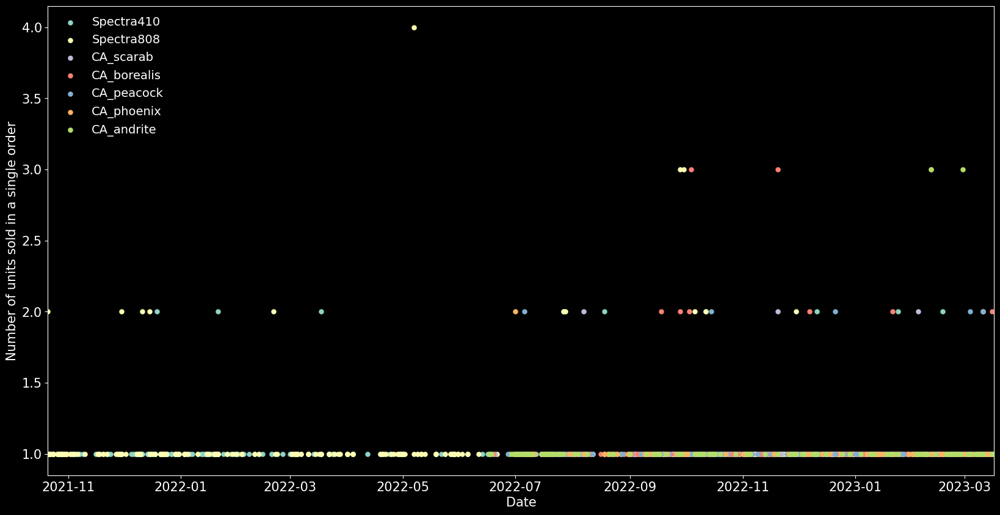

In [31]:
with plt.style.context('dark_background'):
    
    #plt.rcParams['figure.figsize'] = [20, 10]
    fig = plt.figure(dpi=400)
    fig, ax = plt.subplots()
    
    ax.scatter(df_plot['Date'],y1)
    ax.scatter(df_plot['Date'],y2)
    ax.scatter(df_plot['Date'],y3)
    ax.scatter(df_plot['Date'],y4)
    ax.scatter(df_plot['Date'],y5)
    ax.scatter(df_plot['Date'],y6)
    ax.scatter(df_plot['Date'],y7)
    
    plt.rcParams['legend.fontsize'] = 14
    plt.rcParams["font.size"] = 10
    plt.rcParams["legend.frameon"] = 0
    plt.rcParams['patch.linewidth'] = 1
    plt.rcParams['grid.linewidth'] = 0.1

    plt.xlabel('Date', fontsize=15)
    plt.ylabel('Number of units sold in a single order', fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.legend(labels = ['Spectra410', 'Spectra808','CA_scarab', 'CA_borealis', 'CA_peacock', 'CA_phoenix', 'CA_andrite'],loc=2)
    plt.rcParams["font.size"] = 2
    plt.xlim([df_plot['Date'].iloc[10], df_plot['Date'].iloc[len(df_plot)-1]])
    
plt.show();

In [32]:
A = pd.DataFrame()
B = list(df['total_price'])
A['Date'] = df_plot['Date']
A['total_price'] = B
A.head(-10)
total_price = A

In [33]:
A['total_price'] = A['total_price'].astype(float)

In [34]:
C = pd.DataFrame()
C['total_price'] = A.groupby('Date')['total_price'].sum()

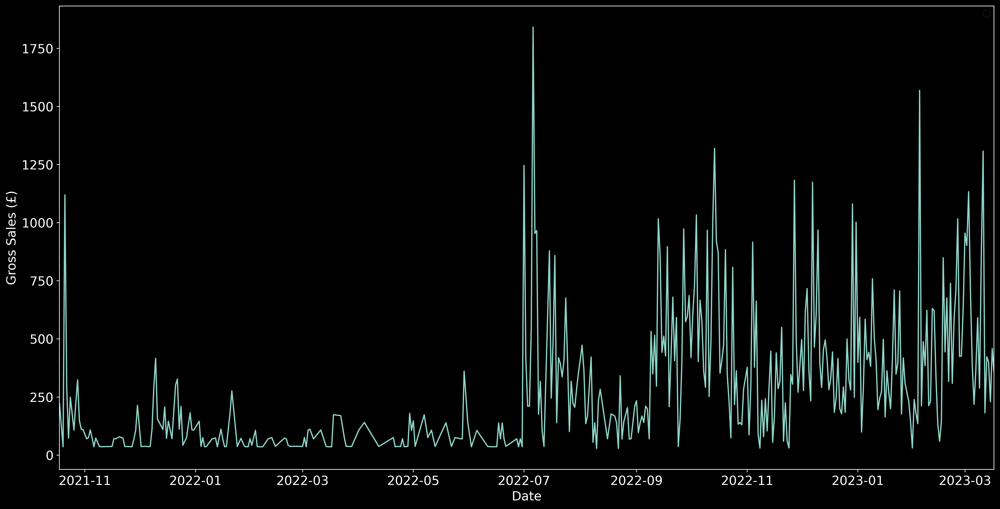

In [35]:
plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
#plt.rcParams["font.size"] = 15;
# fig, ax = plt.subplots()
sns.lineplot(data = C, x = C.index, y = C['total_price']) 
plt.xlabel('Date', fontsize = 15)
plt.ylabel('Gross Sales (£)', fontsize = 15)
plt.xticks(fontsize=15, color = 'white')
plt.yticks(fontsize=15, color = 'white')
plt.legend(labels = [],loc=0)
plt.xlim([df_plot['Date'].iloc[3], df_plot['Date'].iloc[len(df_plot)-1]])
ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval=2))
ax.xaxis.set_major_formatter(DateFormatter("%d/%m/%y"))
plt.show()

In [36]:
x9['number_of_products'] = x9[['Spectra410', 'Spectra808','CA_scarab', 'CA_borealis', 'CA_peacock', 'CA_phoenix', 'CA_andrite']].sum(axis='columns')

In [37]:
A = pd.DataFrame()
B = list(x9['number_of_products'])
A['Date'] = df_plot['Date']
A['number_of_products'] = B

In [38]:
C['number_of_products'] = A.groupby('Date')['number_of_products'].sum()
C['7day_rolling_avg'] = C.number_of_products.rolling( 7).mean()

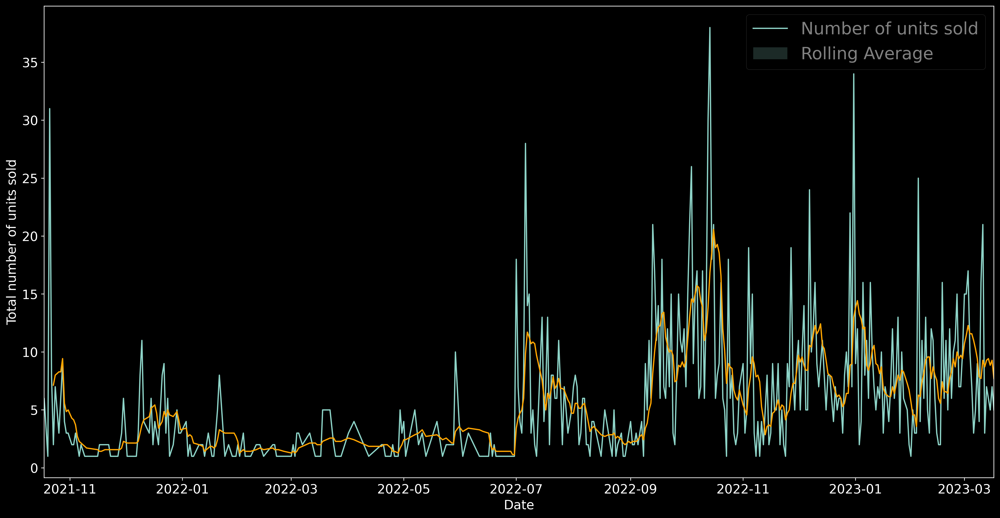

In [39]:


plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
# # plt.rcParams["font.size"] = 15;
# fig, ax = plt.subplots()

sns.lineplot(data = C, x = C.index, y = C['number_of_products']) 
sns.lineplot(data = C, x = C.index, y = C['7day_rolling_avg'], color = 'orange')

plt.xlabel('Date', fontsize = 15)
plt.ylabel('Total number of units sold', fontsize = 15)
plt.xticks(fontsize=15, color = 'white')
plt.yticks(fontsize=15, color = 'white')
plt.legend(labels = ['Number of units sold','Rolling Average'],loc=0, fontsize = 20)
plt.xlim([df_plot['Date'].iloc[3], df_plot['Date'].iloc[len(df_plot)-1]])
ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval=2))
ax.xaxis.set_major_formatter(DateFormatter("%d/%m/%y"))
plt.show()


In [40]:
df_CA = x9[['Date','CA_scarab','CA_borealis','CA_peacock','CA_phoenix','CA_andrite']]
df_CA['CA']= df_CA['CA_scarab']+df_CA['CA_borealis']+df_CA['CA_peacock']+df_CA['CA_phoenix']+df_CA['CA_andrite']
df_CA['Spectra'] = x9['Spectra410']+ x9['Spectra808']

In [41]:
df_CA['total_price'] = total_price['total_price']

In [42]:
df_CA.head(5)

,Date,CA_scarab,CA_borealis,CA_peacock,CA_phoenix,CA_andrite,CA,Spectra,total_price
0,2020-11-16T13:31:26+00:00,1,0,0,0,0,1,0,75.00
1,2021-01-19T09:01:27+00:00,1,0,0,0,0,1,0,175.00
2,2021-10-18T10:57:54+01:00,0,0,0,0,0,0,1,35.99
3,2021-10-18T11:21:17+01:00,0,0,0,0,0,0,2,75.52
4,2021-10-18T11:26:40+01:00,0,0,0,0,0,0,1,36.99


In [43]:
df_CA['Date'] = pd.to_datetime(df_CA['Date'])

In [44]:
date_z = pd.DataFrame()
for i in range(len(df_CA)):
    order_created = df_CA['Date'].iloc[i]  
    date = order_created.strftime("%Y-%m-%d %H:%M:%S")
    date_z = date_z.append(pd.Series(date), ignore_index=True)

In [45]:
date_z.columns = ['formatted_date']

In [46]:
pd.to_datetime(date_z['formatted_date'],format="%Y-%m-%d %H:%M:%S")

0      2020-11-16 13:31:26
1      2021-01-19 09:01:27
2      2021-10-18 10:57:54
3      2021-10-18 11:21:17
4      2021-10-18 11:26:40
               ...        
1742   2023-03-16 22:47:58
1743   2023-03-17 06:33:45
1744   2023-03-17 13:58:39
1745   2023-03-17 16:32:15
1746   2023-03-17 17:45:29
Name: formatted_date, Length: 1747, dtype: datetime64[ns]

In [47]:
df_CA['Date'] = pd.to_datetime(date_z['formatted_date'],format="%Y-%m-%d %H:%M:%S.%f")

In [48]:
df_CA = df_CA.set_index(pd.DatetimeIndex(date_z['formatted_date']))

In [49]:
df_CA.head(5)

,Date,CA_scarab,CA_borealis,CA_peacock,CA_phoenix,CA_andrite,CA,Spectra,total_price
formatted_date,,,,,,,,,
2020-11-16 13:31:26,2020-11-16 13:31:26,1,0,0,0,0,1,0,75.00
2021-01-19 09:01:27,2021-01-19 09:01:27,1,0,0,0,0,1,0,175.00
2021-10-18 10:57:54,2021-10-18 10:57:54,0,0,0,0,0,0,1,35.99
2021-10-18 11:21:17,2021-10-18 11:21:17,0,0,0,0,0,0,2,75.52
2021-10-18 11:26:40,2021-10-18 11:26:40,0,0,0,0,0,0,1,36.99


In [50]:
df_CAM = df_CA
dfm1 = df_CA

In [51]:
dfm1 = pd.DataFrame(dfm1)

In [52]:
dfm1 = dfm1.drop(columns=['Date'])

In [53]:
dfm1 = dfm1.iloc[10:]

In [54]:
dfm1 = dfm1.reset_index()

In [55]:
dfm1 = dfm1.groupby([pd.Grouper(key='formatted_date', freq='D')])[['CA', 'Spectra', 'total_price']].sum()
dfm1 = pd.DataFrame(dfm1)

In [56]:
target_map = dfm1[['CA']].to_dict()
# target_map

In [57]:
def create_features(dfm1):
    """
    Create time series features based on time series index.
    """
    dfm1 = dfm1.copy()
    dfm1['hour'] = dfm1.index.hour
    dfm1['dayofweek'] = dfm1.index.dayofweek
    dfm1['quarter'] = dfm1.index.quarter
    dfm1['month'] = dfm1.index.month
    dfm1['year'] = dfm1.index.year
    dfm1['dayofyear'] = dfm1.index.dayofyear
    dfm1['dayofmonth'] = dfm1.index.day
    dfm1['weekofyear'] = dfm1.index.isocalendar().week
    return dfm1
dfm1 = create_features(dfm1)


In [58]:
dfm1.head(5)

,CA,Spectra,total_price,hour,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear
formatted_date,,,,,,,,,,,
2021-10-21,0,29,1045.30,0,3,4,10,2021,294,21,42
2021-10-22,0,8,292.35,0,4,4,10,2021,295,22,42
2021-10-23,0,2,73.12,0,5,4,10,2021,296,23,42
2021-10-24,0,7,248.65,0,6,4,10,2021,297,24,42
2021-10-25,0,0,0.00,0,0,4,10,2021,298,25,43


In [59]:
X = dfm1
X.fillna(0, inplace = True)
X = X.astype('int')
X.reset_index(inplace= True)
X = X.rename(columns = {'formatted_date':'Date'})

In [60]:
#RUN database_stitching.ipynb

socials_complete = pd.read_csv('socials_complete.csv')

In [61]:
socials_complete['Date'] = pd.to_datetime(socials_complete['Date'])
socials_columns = socials_complete.select_dtypes(exclude=[object]).columns.to_list() # FOR FORECASTING PURPOSES, OBJECTS WILL NOT BE NEEDED
socials_num = socials_complete.groupby([pd.Grouper(key='Date', freq='D')])[socials_columns].sum()
socials_num.reset_index(inplace = True)

In [62]:
A = pd.merge(socials_num, X) #MERGE SOCIALS DATA WITH SALES DATA

In [63]:
A.head(5)

,Date,Unnamed: 0.1,Unnamed: 0,Net Audience Growth,Audience Gained,Sent Messages (Total),Published Posts (Total),Received Messages (Total),Comments,Shares,Post Link Clicks,Saves,Sent Posts (Facebook),Sent Posts (Instagram),Sent Stories (Instagram),Sent Reels (Instagram),Sent Comments (Instagram),Sent Videos (TikTok),Received Comments (Facebook),Received Ad Comments (Facebook),Received Comments (Instagram),Received Mentions (Instagram),Received Media Tags (Instagram),Received Comments (TikTok),Website Traffic,new_ig_followers,new_fb_page_likes,instagram_reach,facebook_reach,CA,Spectra,total_price,hour,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear
0,2022-06-15,3,1209,8.0,17.0,0,0,8,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,2.0,0.0,219,51,0,171,3,0,0,0,0,2,2,6,2022,166,15,24
1,2022-06-16,12,1218,9.0,16.0,0,0,20,1.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,15.0,5.0,0.0,366,48,0,921,9,0,1,35,0,3,2,6,2022,167,16,24
2,2022-06-17,21,1227,4.0,8.0,0,0,2,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,222,24,0,219,6,1,2,137,0,4,2,6,2022,168,17,24
3,2022-06-18,30,1236,9.0,20.0,0,0,8,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,4.0,0.0,102,57,3,135,36,1,0,70,0,5,2,6,2022,169,18,24
4,2022-06-19,39,1245,21.0,21.0,0,0,3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,180,63,0,189,18,2,0,137,0,6,2,6,2022,170,19,24


In [64]:
#Drop old indexes from socials data

A=A.drop(columns=['Unnamed: 0','Unnamed: 0.1', 'hour']) 

## **EDA OF COMPLETE DATASET**

##  DATA INSPECTION

In [65]:
display(A.head(5))

,Date,Net Audience Growth,Audience Gained,Sent Messages (Total),Published Posts (Total),Received Messages (Total),Comments,Shares,Post Link Clicks,Saves,Sent Posts (Facebook),Sent Posts (Instagram),Sent Stories (Instagram),Sent Reels (Instagram),Sent Comments (Instagram),Sent Videos (TikTok),Received Comments (Facebook),Received Ad Comments (Facebook),Received Comments (Instagram),Received Mentions (Instagram),Received Media Tags (Instagram),Received Comments (TikTok),Website Traffic,new_ig_followers,new_fb_page_likes,instagram_reach,facebook_reach,CA,Spectra,total_price,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear
0,2022-06-15,8.0,17.0,0,0,8,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,2.0,0.0,219,51,0,171,3,0,0,0,2,2,6,2022,166,15,24
1,2022-06-16,9.0,16.0,0,0,20,1.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,15.0,5.0,0.0,366,48,0,921,9,0,1,35,3,2,6,2022,167,16,24
2,2022-06-17,4.0,8.0,0,0,2,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,222,24,0,219,6,1,2,137,4,2,6,2022,168,17,24
3,2022-06-18,9.0,20.0,0,0,8,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,4.0,0.0,102,57,3,135,36,1,0,70,5,2,6,2022,169,18,24
4,2022-06-19,21.0,21.0,0,0,3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,180,63,0,189,18,2,0,137,6,2,6,2022,170,19,24


### NUMERICAL INSPECTION AND SUMMARIES

In [66]:
A.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 270 entries, 0 to 269
Data columns (total 37 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   Date                             270 non-null    datetime64[ns]
 1   Net Audience Growth              270 non-null    float64       
 2   Audience Gained                  270 non-null    float64       
 3   Sent Messages (Total)            270 non-null    int64         
 4   Published Posts (Total)          270 non-null    int64         
 5   Received Messages (Total)        270 non-null    int64         
 6   Comments                         270 non-null    float64       
 7   Shares                           270 non-null    float64       
 8   Post Link Clicks                 270 non-null    float64       
 9   Saves                            270 non-null    float64       
 10  Sent Posts (Facebook)            270 non-null    float64      

In [67]:
A.loc[:, ~A.columns.isin(['total_price', 'Date'])] = A.loc[:, ~A.columns.isin(['total_price', 'Date'])].astype(int)

In [68]:
A.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 270 entries, 0 to 269
Data columns (total 37 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   Date                             270 non-null    datetime64[ns]
 1   Net Audience Growth              270 non-null    int64         
 2   Audience Gained                  270 non-null    int64         
 3   Sent Messages (Total)            270 non-null    int64         
 4   Published Posts (Total)          270 non-null    int64         
 5   Received Messages (Total)        270 non-null    int64         
 6   Comments                         270 non-null    int64         
 7   Shares                           270 non-null    int64         
 8   Post Link Clicks                 270 non-null    int64         
 9   Saves                            270 non-null    int64         
 10  Sent Posts (Facebook)            270 non-null    int64        

**Missing values check**

In [69]:
A.isna().sum()

Date                               0
Net Audience Growth                0
Audience Gained                    0
Sent Messages (Total)              0
Published Posts (Total)            0
Received Messages (Total)          0
Comments                           0
Shares                             0
Post Link Clicks                   0
Saves                              0
Sent Posts (Facebook)              0
Sent Posts (Instagram)             0
Sent Stories (Instagram)           0
Sent Reels (Instagram)             0
Sent Comments (Instagram)          0
Sent Videos (TikTok)               0
Received Comments (Facebook)       0
Received Ad Comments (Facebook)    0
Received Comments (Instagram)      0
Received Mentions (Instagram)      0
Received Media Tags (Instagram)    0
Received Comments (TikTok)         0
Website Traffic                    0
new_ig_followers                   0
new_fb_page_likes                  0
instagram_reach                    0
facebook_reach                     0
C

In [70]:
A.duplicated().sum()

0

## UNIVARIATE ANALYSIS

In [71]:
key_columns = A.loc[:,~A.columns.isin(['dayofweek','Date','quarter','month','year','dayofyear','dayofmonth','weekofyear'])].columns

In [72]:
key_columns = key_columns.to_list()
key_columns

['Net Audience Growth',
 'Audience Gained',
 'Sent Messages (Total)',
 'Published Posts (Total)',
 'Received Messages (Total)',
 'Comments',
 'Shares',
 'Post Link Clicks',
 'Saves',
 'Sent Posts (Facebook)',
 'Sent Posts (Instagram)',
 'Sent Stories (Instagram)',
 'Sent Reels (Instagram)',
 'Sent Comments (Instagram)',
 'Sent Videos (TikTok)',
 'Received Comments (Facebook)',
 'Received Ad Comments (Facebook)',
 'Received Comments (Instagram)',
 'Received Mentions (Instagram)',
 'Received Media Tags (Instagram)',
 'Received Comments (TikTok)',
 'Website Traffic',
 'new_ig_followers',
 'new_fb_page_likes',
 'instagram_reach',
 'facebook_reach',
 'CA',
 'Spectra',
 'total_price']

<Figure size 8000x4000 with 0 Axes>

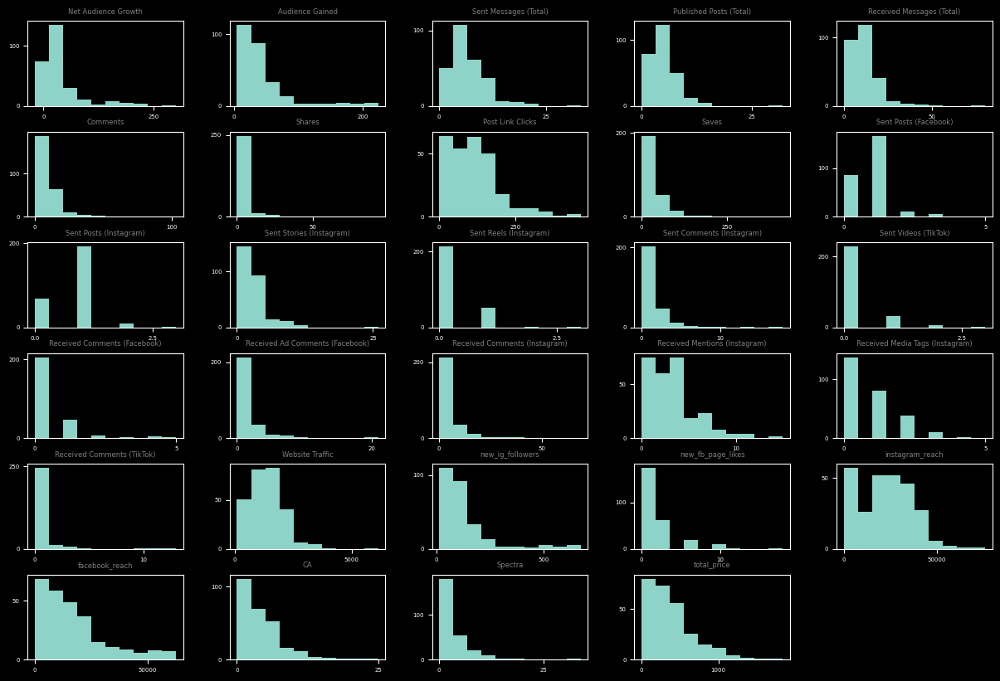

In [73]:
# plot the histograms of the key columns

plt.rcParams['figure.figsize'] = [20, 10]
plt.rcParams["font.size"] = 5;
fig = plt.figure(dpi=400)

A.loc[:,key_columns].hist(figsize = (15, 10), grid = False);
plt.rcParams["font.size"] = 100;
plt.show()

<Figure size 20000x8000 with 0 Axes>

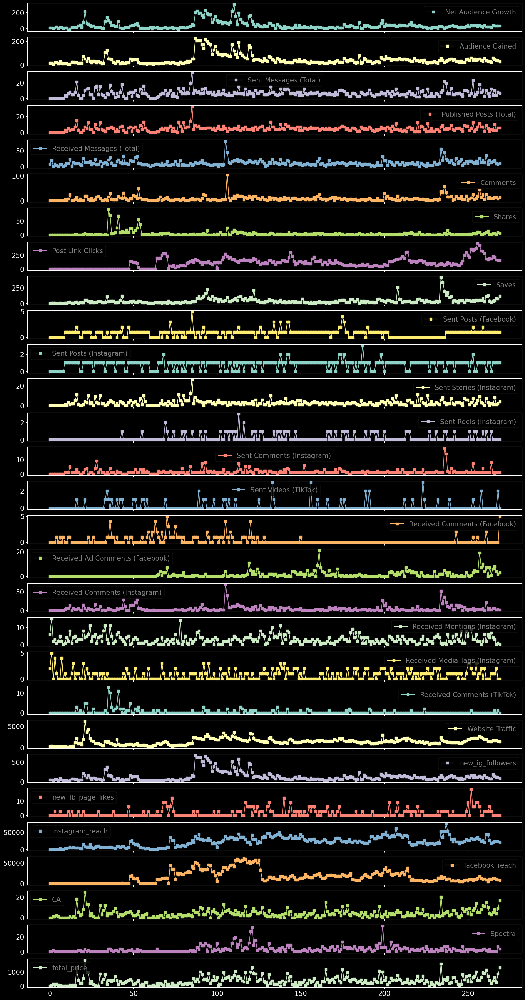

In [74]:

plt.rcParams['figure.figsize'] = [50, 20]
plt.rcParams["font.size"] = 15;
fig = plt.figure(dpi=400)
A[key_columns].plot.line(figsize = (20, 40), subplots=True, marker = 's');
plt.show()

### Bivariate Analysis

In [75]:
# sns.pairplot(A[key_columns], diag_kind = 'kde');
# plt.show()

In [76]:
B = A.corr().round(2)

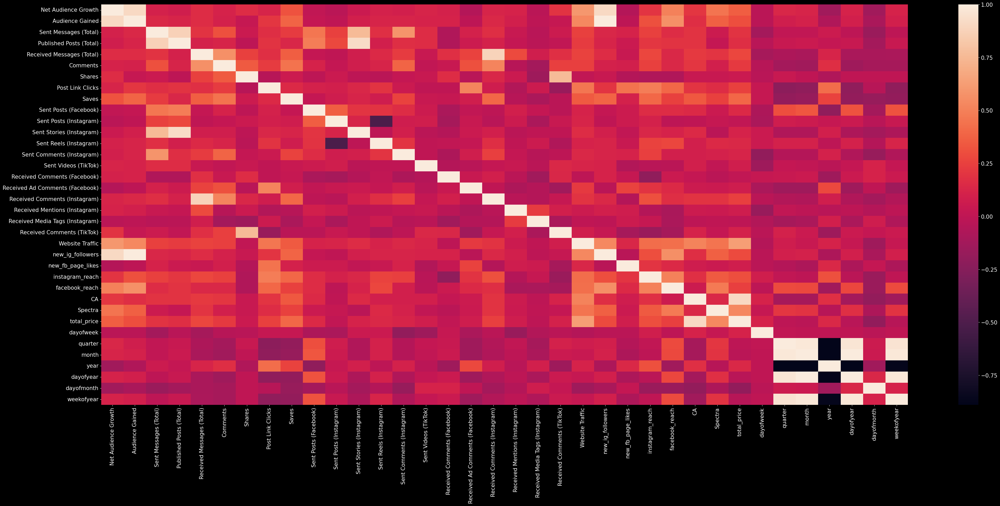

In [77]:
sns.heatmap(B)
plt.show()

In [78]:
abs(B['total_price']).sort_values(ascending=False)

total_price                        1.00
CA                                 0.91
Website Traffic                    0.63
Spectra                            0.53
Saves                              0.40
Net Audience Growth                0.36
instagram_reach                    0.30
Audience Gained                    0.30
new_ig_followers                   0.29
Received Messages (Total)          0.27
Post Link Clicks                   0.25
Received Comments (Instagram)      0.24
facebook_reach                     0.24
Comments                           0.22
dayofmonth                         0.20
Sent Messages (Total)              0.19
Published Posts (Total)            0.17
Sent Posts (Facebook)              0.15
Sent Reels (Instagram)             0.14
year                               0.14
Sent Comments (Instagram)          0.12
dayofweek                          0.11
Sent Stories (Instagram)           0.11
Received Comments (TikTok)         0.10
Sent Videos (TikTok)               0.08


**Since the aim of this work is to create a forecasting tool to help with marketing activities. It was decided to use Website Traffic and Net Audience Growth as key metrics to be assessed and optimised. Threfore, these are the only variables that will be considered in this work. In the future, a second model, more specific for marketing will be developed where the other metrics, will be taking into consideration and the target will be "Website Traffic" and "Net Audience Growth". The objective will be to assess how marketing activations influence on these two metrics and, coupled with the forecasting model, give insights on which type of activations maximise sales.**

<Figure size 8000x4000 with 0 Axes>

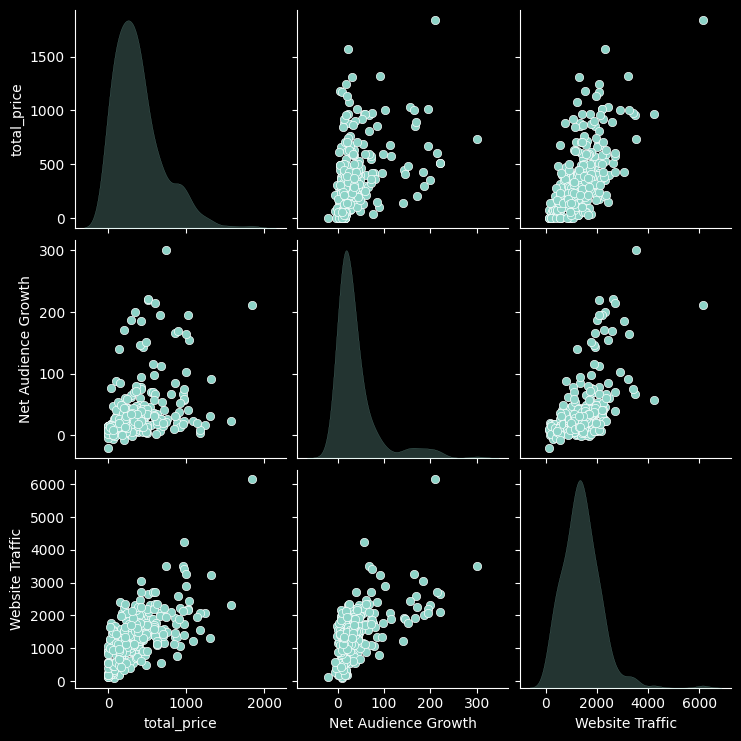

In [79]:
plt.rcParams['figure.figsize'] = [20, 10]
plt.rcParams["font.size"] = 10;
fig = plt.figure(dpi=400)
sns.pairplot(A[['total_price','Net Audience Growth', 'Website Traffic']], diag_kind = 'kde');
plt.show()

In [80]:
#B=pd.DataFrame(B)
#B = B.drop(columns=['total_price'])
#features = B.columns[(abs(B.loc['total_price'])>=0.1)].to_list() #If features decided upon linear correlation
# features =B.columns.to_list()

In [81]:
features = pd.DataFrame(columns=['features'])
# features.columns = ['features']
# features

In [82]:
# features = pd.DataFrame(features)
# features.columns = ['features']
# features

In [83]:
#REMOVE TARGETS AND NUMBER OF PRODUCTS SOLD TO AVOID DATA LEAKAGE

# values = ['Spectra', 'total_price', 'CA']

# #Drop rows that contain any target value/ information in the list.
# features = features[features.features.isin(values) == False]

In [84]:
#DEFINE RELEVANT FEATURES (COMMENT OUT THIS *AND* THE ABOVE CELL IF ALL FEATURES ARE RELEVANT )

# values = ['Net Audience Growth', 'Website Traffic', 'dayofweek', 'quarter', 'month', 'dayofmonth', 'weekofyear']
# features = features[features.features.isin(values) == True]

In [85]:
features['features'] = ['Net Audience Growth', 'Website Traffic', 'dayofweek', 'quarter', 'month', 'dayofmonth', 'weekofyear']

In [86]:
dfm1=A
dfm1.set_index('Date', inplace=True)
dfm1.head()

,Net Audience Growth,Audience Gained,Sent Messages (Total),Published Posts (Total),Received Messages (Total),Comments,Shares,Post Link Clicks,Saves,Sent Posts (Facebook),Sent Posts (Instagram),Sent Stories (Instagram),Sent Reels (Instagram),Sent Comments (Instagram),Sent Videos (TikTok),Received Comments (Facebook),Received Ad Comments (Facebook),Received Comments (Instagram),Received Mentions (Instagram),Received Media Tags (Instagram),Received Comments (TikTok),Website Traffic,new_ig_followers,new_fb_page_likes,instagram_reach,facebook_reach,CA,Spectra,total_price,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2022-06-15,8,17,0,0,8,0,0,0,1,0,0,0,0,0,0,0,0,0,6,2,0,219,51,0,171,3,0,0,0,2,2,6,2022,166,15,24
2022-06-16,9,16,0,0,20,1,0,0,2,0,0,0,0,0,0,0,0,0,15,5,0,366,48,0,921,9,0,1,35,3,2,6,2022,167,16,24
2022-06-17,4,8,0,0,2,0,0,0,4,0,0,0,0,0,0,0,0,0,2,0,0,222,24,0,219,6,1,2,137,4,2,6,2022,168,17,24
2022-06-18,9,20,0,0,8,0,0,0,2,0,0,0,0,0,0,0,0,0,3,4,0,102,57,3,135,36,1,0,70,5,2,6,2022,169,18,24
2022-06-19,21,21,0,0,3,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,180,63,0,189,18,2,0,137,6,2,6,2022,170,19,24


#### ADDING LAG FEATURES

In [87]:
t1='30 days'
t1_n = 30
t2='60 days'
t3='90 days'

features_2 = pd.DataFrame()

for i in range(len(features)):

    lagged_feature = features['features'].iloc[i]
    target_map = dfm1[lagged_feature].to_dict()
    dfm1[f"{lagged_feature}_lag1"] = (dfm1.index - pd.Timedelta(t1)).map(target_map)
    dfm1[f"{lagged_feature}_lag2"] = (dfm1.index - pd.Timedelta(t2)).map(target_map)
    dfm1[f"{lagged_feature}_lag3"] = (dfm1.index - pd.Timedelta(t3)).map(target_map)
    
    features_2 = features_2.append([f"{lagged_feature}",f"{lagged_feature}_lag1",f"{lagged_feature}_lag2",f"{lagged_feature}_lag3"])

In [88]:
features_2.columns = ['features']
features_2.reset_index(inplace = True)
features = features_2

In [89]:
dfm1.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 270 entries, 2022-06-15 to 2023-03-11
Data columns (total 57 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Net Audience Growth              270 non-null    int64  
 1   Audience Gained                  270 non-null    int64  
 2   Sent Messages (Total)            270 non-null    int64  
 3   Published Posts (Total)          270 non-null    int64  
 4   Received Messages (Total)        270 non-null    int64  
 5   Comments                         270 non-null    int64  
 6   Shares                           270 non-null    int64  
 7   Post Link Clicks                 270 non-null    int64  
 8   Saves                            270 non-null    int64  
 9   Sent Posts (Facebook)            270 non-null    int64  
 10  Sent Posts (Instagram)           270 non-null    int64  
 11  Sent Stories (Instagram)         270 non-null    int64  
 12  Sen

## **CROSSVALIDATION**

##### TWO METHODS WERE TESTED: (1) REGULAR TIME SERIES SPLIT & (2) BLOCKING TIME SERIES SPLIT

In [90]:
#SET NUMBER OF SPLITS

n_splits = 4

In [91]:
tss = TimeSeriesSplit(n_splits, test_size=30, gap = 0)
dfm1 = dfm1.sort_index()
dfm1.head(5)

,Net Audience Growth,Audience Gained,Sent Messages (Total),Published Posts (Total),Received Messages (Total),Comments,Shares,Post Link Clicks,Saves,Sent Posts (Facebook),Sent Posts (Instagram),Sent Stories (Instagram),Sent Reels (Instagram),Sent Comments (Instagram),Sent Videos (TikTok),Received Comments (Facebook),Received Ad Comments (Facebook),Received Comments (Instagram),Received Mentions (Instagram),Received Media Tags (Instagram),Received Comments (TikTok),Website Traffic,new_ig_followers,new_fb_page_likes,instagram_reach,...,year,dayofyear,dayofmonth,weekofyear,Net Audience Growth_lag1,Net Audience Growth_lag2,Net Audience Growth_lag3,Website Traffic_lag1,Website Traffic_lag2,Website Traffic_lag3,dayofweek_lag1,dayofweek_lag2,dayofweek_lag3,quarter_lag1,quarter_lag2,quarter_lag3,month_lag1,month_lag2,month_lag3,dayofmonth_lag1,dayofmonth_lag2,dayofmonth_lag3,weekofyear_lag1,weekofyear_lag2,weekofyear_lag3
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2022-06-15,8,17,0,0,8,0,0,0,1,0,0,0,0,0,0,0,0,0,6,2,0,219,51,0,171,...,2022,166,15,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-06-16,9,16,0,0,20,1,0,0,2,0,0,0,0,0,0,0,0,0,15,5,0,366,48,0,921,...,2022,167,16,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-06-17,4,8,0,0,2,0,0,0,4,0,0,0,0,0,0,0,0,0,2,0,0,222,24,0,219,...,2022,168,17,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-06-18,9,20,0,0,8,0,0,0,2,0,0,0,0,0,0,0,0,0,3,4,0,102,57,3,135,...,2022,169,18,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-06-19,21,21,0,0,3,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,180,63,0,189,...,2022,170,19,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<Figure size 8000x4000 with 0 Axes>

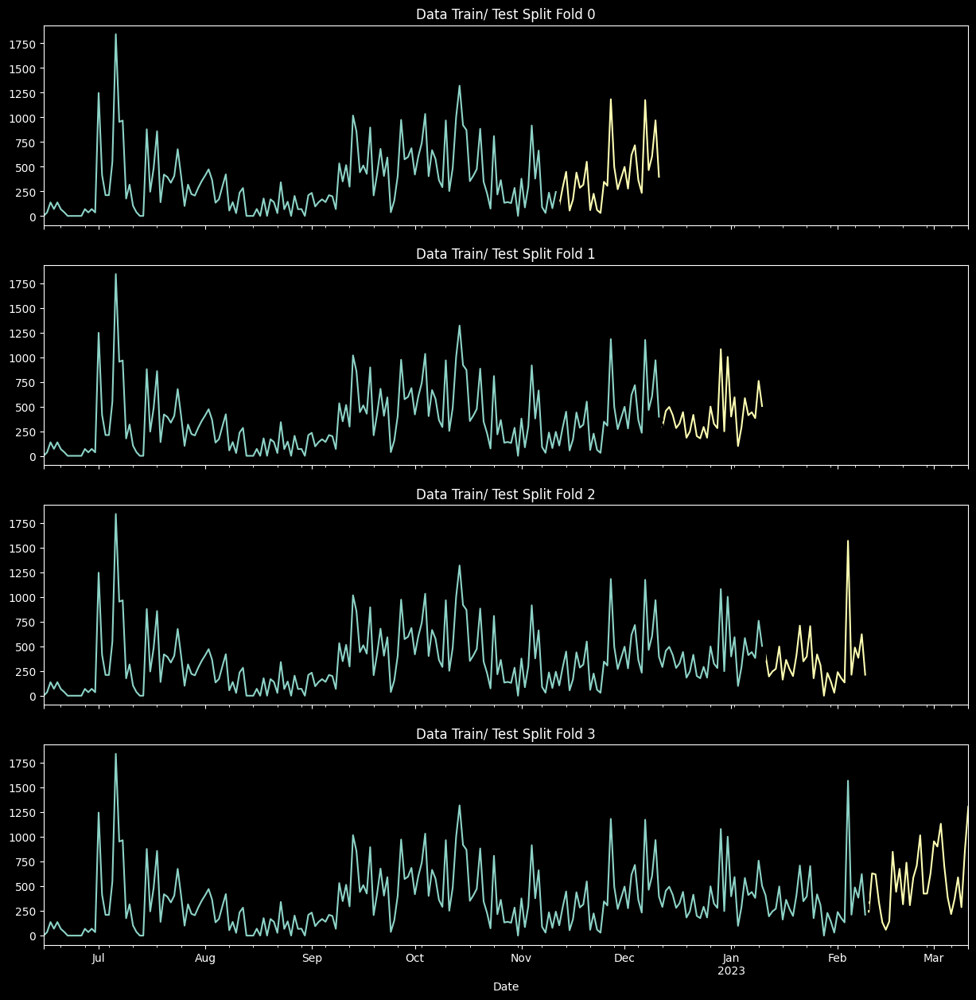

In [92]:
plt.rcParams['figure.figsize'] = [20, 10]
plt.rcParams["font.size"] = 10
plt.rcParams["text.color"] = 'white'
fig = plt.figure(dpi=400)

fig, axs = plt.subplots(n_splits,1, figsize = (15,15),
                        sharex=True)
fold = 0
for train_idx, val_idx in tss.split(dfm1):
    train = dfm1.iloc[train_idx]
    test = dfm1.iloc[val_idx]
    train['total_price'].plot(ax=axs[fold],
                              label='Training Set',
                              title = f'Data Train/ Test Split Fold {fold}')
    test['total_price'].plot(ax=axs[fold], label = 'Test Set')
    axs[fold].axvline(test.index.min(), color='black',ls='--')
    fold += 1
plt.show()

In [93]:
class BlockingTimeSeriesSplit():
    def __init__(self, n_splits):
        self.n_splits = n_splits
    
    def get_n_splits(self, X, y, groups):
        return self.n_splits
    
    def split(self, X, y=None, groups=None):
        n_samples = len(X)
        k_fold_size = n_samples // self.n_splits
        indices = np.arange(n_samples)

        margin = 0
        for i in range(self.n_splits):
            start = i * k_fold_size
            stop = start + k_fold_size
            mid = int(0.75 * (stop - start)) + start
            yield indices[start: mid], indices[mid + margin: stop]

<Figure size 8000x4000 with 0 Axes>

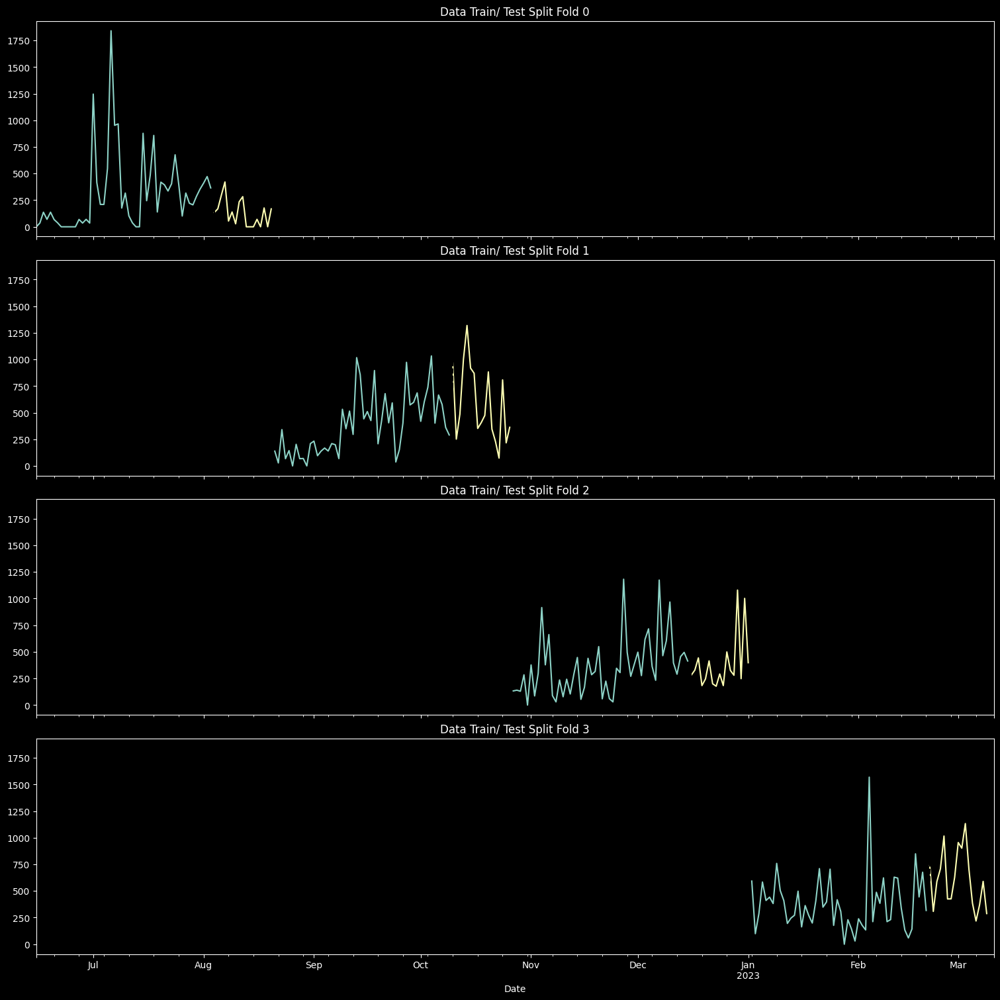

In [94]:
plt.rcParams['figure.figsize'] = [20, 10]
plt.rcParams["text.color"] = 'white'
plt.rcParams["font.size"] = 10
fig = plt.figure(dpi=400)

fig, axs = plt.subplots(n_splits,1, figsize = (15,15), sharex =True,
                       sharey=True,constrained_layout=True)
fold = 0
btscv = BlockingTimeSeriesSplit(n_splits)
for train_idx, val_idx in btscv.split(dfm1):
    train = dfm1.iloc[train_idx]
    test = dfm1.iloc[val_idx]
    train['total_price'].plot(ax=axs[fold],
                              label='Training Set',
                              title = f'Data Train/ Test Split Fold {fold}',
                              xlim=[dfm1.index.min(), dfm1.index.max()])
    test['total_price'].plot(ax=axs[fold], label = 'Test Set',
                             xlim=[dfm1.index.min(), dfm1.index.max()])
    axs[fold].axvline(test.index.min(), color='black',ls='--')
    fold += 1

ax.set()
plt.show()

# HYPERPARAMETER TUNING

In [95]:
dfm1 = dfm1.fillna(0) #Remove NAs from lag features

In [96]:
FEATURES = features['features']
TARGET = 'total_price'

In [97]:
#DEFINE TRAIN-TEST SPLIT PERCENTAGE

split=0.25 
train = dfm1[:-(round(len(X)*split))]
test = dfm1[-(round(len(X)*split)):]

X_train = train[FEATURES]
y_train = train[TARGET]    
X_test = test[FEATURES]
y_test = test[TARGET]

Text(0, 0.5, '')

<Figure size 16000x20000 with 0 Axes>

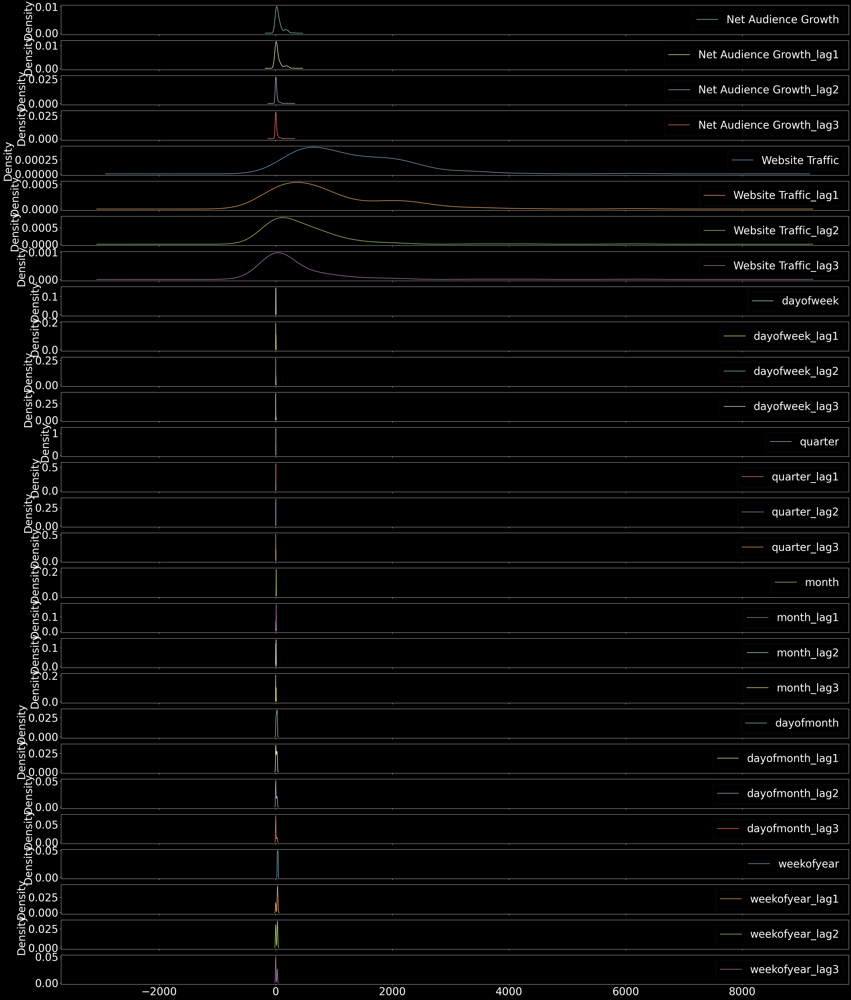

In [98]:
plt.rcParams['figure.figsize'] = [40, 50]
plt.rcParams["font.size"] = 30
plt.rcParams["text.color"] = 'white'
fig = plt.figure(dpi=400)

X_train.plot(kind = 'kde', subplots= True)
plt.ylabel(None)

In [99]:
#SCALE DATA
scaler = StandardScaler()
# train data 
X_train = scaler.fit_transform(X_train)
# test data 
X_test = scaler.transform(X_test)

Text(0, 0.5, '')

<Figure size 16000x20000 with 0 Axes>

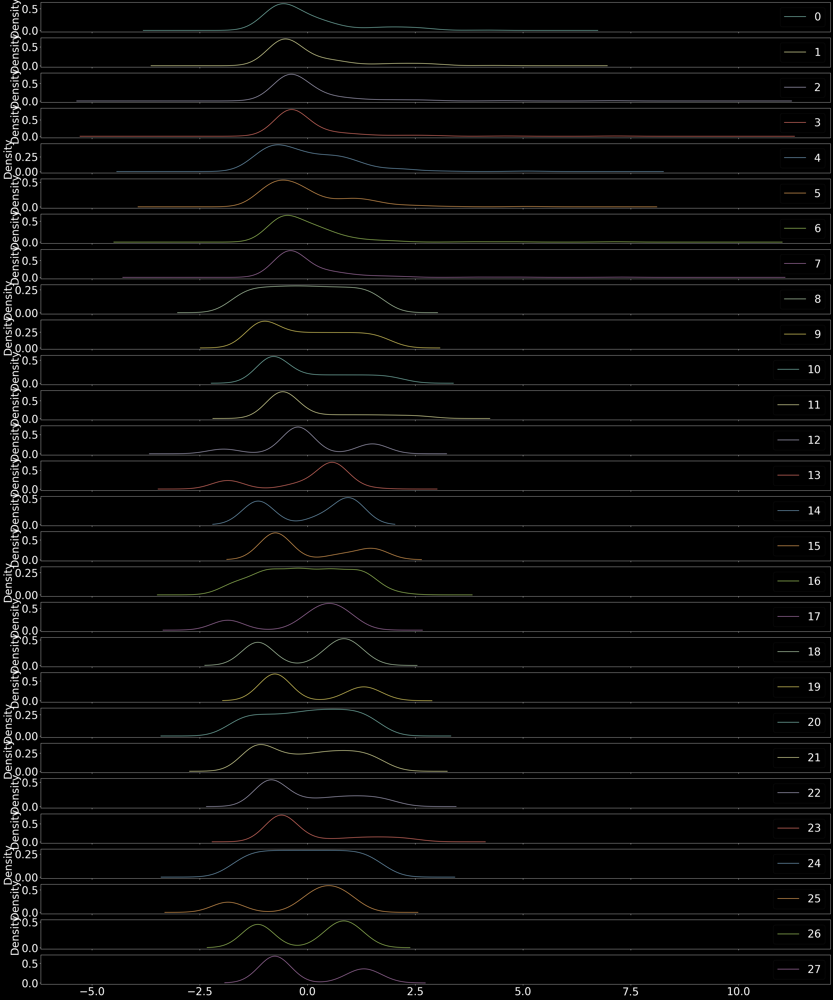

In [100]:
plt.rcParams['figure.figsize'] = [40, 50]
plt.rcParams["font.size"] = 30
plt.rcParams["text.color"] = 'white'
fig = plt.figure(dpi=400)

X_train_scaled = pd.DataFrame(X_train)

X_train_scaled.plot(kind = 'kde', subplots= True)
#plt.legend()
plt.ylabel(None)

### XGBOOST WITH REGULAR TIME SERIES SPLIT (NO CROSS VALIDATION)

In [101]:
model =  xgb.XGBRegressor(booster='gbtree', objective = 'reg:squarederror')

params = {
    "n_estimators": [100, 300, 500],
    "max_depth": [3, 6, 9],
    "learning_rate": [0.01, 0.4, 1],
}

finder = GridSearchCV(
        estimator=model,
        param_grid=params,
        cv=None,  
        verbose=True, 
        n_jobs = 5,
)

finder.fit(X_train, y_train)
best_params = finder.best_params_
gridcv_xgb = finder.best_estimator_
print(f'Best parameters are: {best_params}')

Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best parameters are: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}


In [102]:
y_pred = gridcv_xgb.predict(X_test)
score = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'MSE of XGBoost using GridSeachCV & Regular Train Test Split: {score}')

MSE of XGBoost using GridSeachCV & Regular Train Test Split: 354.1326475260984


#### GRID SEARCH CV WITH K-FOLD TIME SERIES SPLIT

In [103]:
model =  xgb.XGBRegressor(booster='gbtree', objective = 'reg:squarederror')

params = {
    "n_estimators": [100, 300, 500],
    "max_depth": [3, 6, 9],
    "learning_rate": [0.01, 0.4, 1],
}

finder = GridSearchCV(
        estimator=model,
        param_grid=params,
        cv=tss,  
        verbose=True, 
        n_jobs = 5,
)

finder.fit(X_train, y_train)
best_params = finder.best_params_
gridcv_xgb = finder.best_estimator_
print(f'Best parameters are: {best_params}')

Fitting 4 folds for each of 27 candidates, totalling 108 fits
Best parameters are: {'learning_rate': 0.01, 'max_depth': 6, 'n_estimators': 100}


In [104]:
y_pred = gridcv_xgb.predict(X_test)
score = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'MSE of XGBoost using GridSeachCV & k-fold train test split: {score}')

MSE of XGBoost using GridSeachCV & k-fold train test split: 362.37254608483005


#### GRID SEARCH CV WITH BLOCKING TIME SERIES SPLIT

In [105]:
model =  xgb.XGBRegressor(booster='gbtree', objective = 'reg:squarederror')

params = {
    "n_estimators": [100, 300, 500],
    "max_depth": [3, 6, 9],
    "learning_rate": [0.01, 0.4, 1],
}

finder = GridSearchCV(
        estimator=model,
        param_grid=params,
        cv=btscv,  
        verbose=True, 
        n_jobs = 5,
)

finder.fit(X_train, y_train)
best_params = finder.best_params_
gridcv_xgb = finder.best_estimator_
print(f'Best parameters are: {best_params}')

Fitting 4 folds for each of 27 candidates, totalling 108 fits
Best parameters are: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}


In [106]:
y_pred = gridcv_xgb.predict(X_test)
score = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'MSE of XGBoost using GridSeachCV & Blocking Train Test Split: {score}')


MSE of XGBoost using GridSeachCV & Blocking Train Test Split: 354.1326475260984


### PARAMETER SEARCH USING ITERATIVE METHOD FOR K-FOLD TIME SERIES SPLIT

In [107]:
i=0
fold = 0
preds = []
scores = []
for train_idx, val_idx in tss.split(dfm1):
    train = dfm1.iloc[train_idx]
    test = dfm1.iloc[val_idx]  
    X_train = train[FEATURES]
    y_train = train[TARGET]    
    X_test = test[FEATURES]
    y_test = test[TARGET]  
    
    #Grid Search    
    for ne in np.linspace(50,500, 5):
        for md in np.linspace(3,12,4):
                for lr in np.linspace(0.001, 1, 10):
                # pre-processing
                    scaler = StandardScaler()
                    # train data 
                    X_train = scaler.fit_transform(X_train)
                    # test data 
                    X_test = scaler.transform(X_test) 
                    X_train = pd.DataFrame(X_train)
                    X_train.columns = features['features']
                    X_test= pd.DataFrame(X_test)
                    X_test.columns = features['features']
                    regr = xgb.XGBRegressor( 
                                            booster='gbtree',    
                                            n_estimators = int(ne),
                                            objective = 'reg:squarederror',
                                            max_depth = int(md),
                                            learning_rate = lr)
                    regr.fit(X_train, y_train,
                             eval_set=[(X_train, y_train), (X_test, y_test)],#,
                             verbose=False);                   
                    y_pred = regr.predict(X_test)
                    score = np.sqrt(mean_squared_error(y_test, y_pred))
                    scores.append([i, 
                                  int(ne), 
                                  int(md),  
                                  lr,
                                  score])                
    i += 1
print('Grid Search Completed')

Grid Search Completed


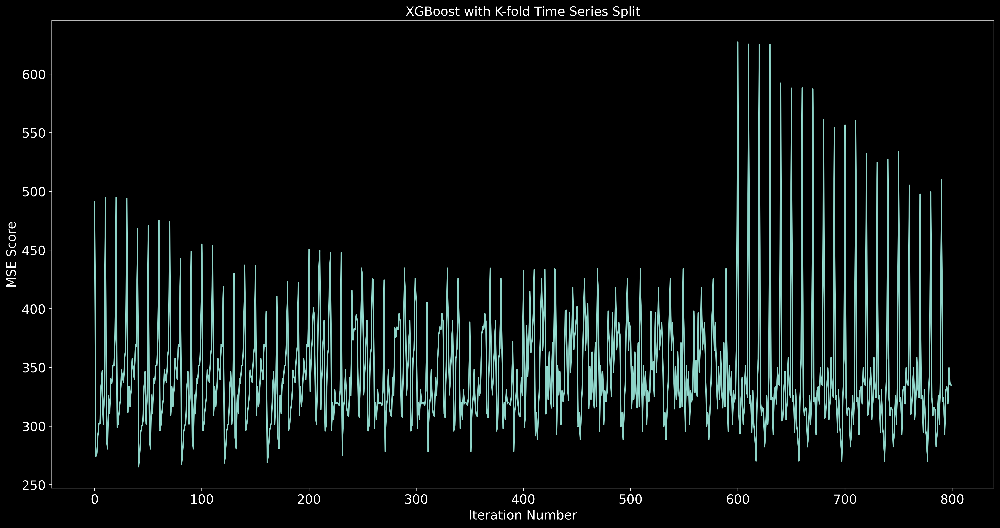

In [108]:
plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
plt.xlabel('Iteration Number', fontsize = 15)
plt.ylabel('MSE Score', fontsize = 15)
plt.xticks(fontsize=15, color = 'white')
plt.yticks(fontsize=15, color = 'white')
plt.title('XGBoost with K-fold Time Series Split', fontsize=15, color='white')
scores_df = pd.DataFrame(scores)
scores_df.columns = ['i','ne','md', 'lr','scores']
plt.plot(scores_df['scores'])
plt.show()

In [109]:
best_params_method2 = scores_df.sort_values(by=['scores']).reset_index()
best_params_method2 = best_params_method2.iloc[0]
scores = best_params_method2['scores']
print(f'MSE of Iterative Method and K-fold Time Split Series: {scores}') 

MSE of Iterative Method and K-fold Time Split Series: 265.3233920709242


### PARAMETER SEARCH USING ITERATIVE METHOD FOR BLOCKING TIME SERIES SPLIT

In [110]:
i=0
fold = 0
preds = []
scores = []
for train_idx, val_idx in btscv.split(dfm1):
    train = dfm1.iloc[train_idx]
    test = dfm1.iloc[val_idx]  
    X_train = train[FEATURES]
    y_train = train[TARGET]    
    X_test = test[FEATURES]
    y_test = test[TARGET]  
    
    #Grid Search    
    for ne in np.linspace(50,500, 5):
        for md in np.linspace(3,12,4):
                for lr in np.linspace(0.001, 1, 10):
                # pre-processing
                    scaler = StandardScaler()
                    # train data 
                    X_train = scaler.fit_transform(X_train)
                    # test data 
                    X_test = scaler.transform(X_test)
                    X_train = pd.DataFrame(X_train)
                    X_train.columns = features['features']
                    X_test= pd.DataFrame(X_test)
                    X_test.columns = features['features']
                    regr = xgb.XGBRegressor(booster='gbtree',    
                                            n_estimators = int(ne),
                                            objective = 'reg:squarederror',
                                            max_depth = int(md),
                                            learning_rate = lr)
                    regr.fit(X_train, y_train,
                             eval_set=[(X_train, y_train), (X_test, y_test)],#,
                             verbose=False);                   
                    y_pred = regr.predict(X_test)
                    score = np.sqrt(mean_squared_error(y_test, y_pred))
                    scores.append([i, 
                                  ne, 
                                  md,  
                                  lr,
                                  score])                
    i += 1
print('Grid Search Completed')

Grid Search Completed


In [111]:
scores_df = pd.DataFrame(scores)
scores_df.columns = ['i','ne','md', 'lr','scores']

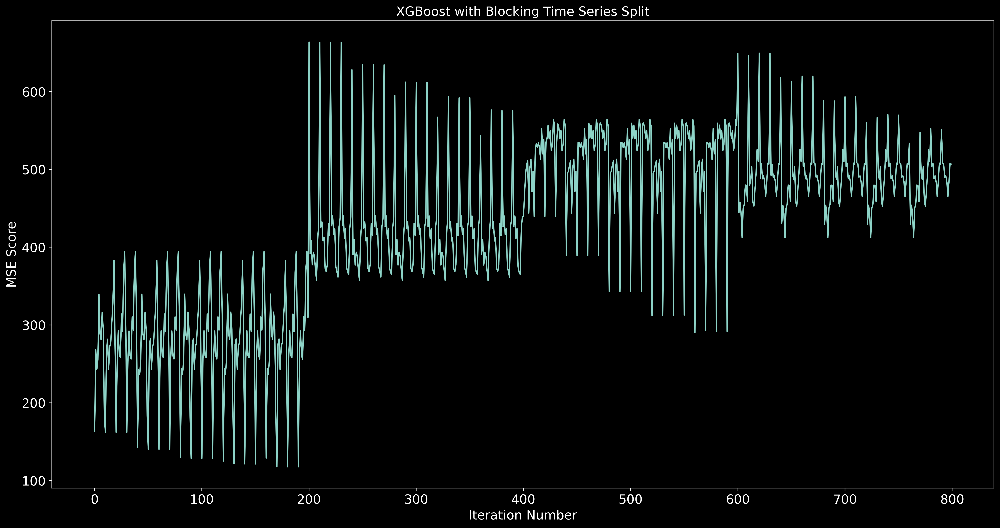

In [112]:
plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
plt.xlabel('Iteration Number', fontsize = 15)
plt.ylabel('MSE Score', fontsize = 15)
plt.xticks(fontsize=15, color = 'white')
plt.yticks(fontsize=15, color = 'white')
plt.title('XGBoost with Blocking Time Series Split', fontsize=15, color='white')
scores_df = pd.DataFrame(scores)
scores_df.columns = ['i','ne','md', 'lr','scores']
plt.plot(scores_df['scores'])
plt.show()



In [113]:
scores_df

best_params_method2_btscv = scores_df.sort_values(by=['scores']).reset_index()
best_params_method2_btscv = best_params_method2_btscv.iloc[0]
best_params_method2_btscv

index     190.000000
i           0.000000
ne        500.000000
md         12.000000
lr          0.001000
scores    117.603468
Name: 0, dtype: float64

In [114]:
scores = scores_df.sort_values(by=['scores']).reset_index()
scores = scores.iloc[0]
scores = scores['scores']
print(f'MSE of Iterative Method and Blocking Time Split Series: {scores}')

MSE of Iterative Method and Blocking Time Split Series: 117.60346783057055


### XGBOOST WITH REGULAR TRAIN TEST SPLIT (NO CROSS VALIDATION)

In [115]:
train = dfm1[:-(round(len(X)*split))]
test = dfm1[-(round(len(X)*split)):]

FEATURES = features['features']
TARGET = 'total_price'

In [116]:
X_train = train[FEATURES]
y_train = train[TARGET]    
X_test = test[FEATURES]
y_test = test[TARGET]  

scores = []
score = []
#Grid Search    
for ne in np.linspace(50,500, 5):
    for md in np.linspace(3,12,4):
            for lr in np.linspace(0.001, 1, 10):
            # pre-processing
                scaler = StandardScaler()
                # train data 
                X_train = scaler.fit_transform(X_train)
                # test data 
                X_test = scaler.transform(X_test)
                X_train = pd.DataFrame(X_train)
                X_train.columns = features['features']
                X_test= pd.DataFrame(X_test)
                X_test.columns = features['features']
                regr = xgb.XGBRegressor(
                                        booster='gbtree',    
                                        n_estimators = int(ne),
                                        objective = 'reg:squarederror',
                                        max_depth = int(md),
                                        learning_rate = lr)
                regr.fit(X_train, y_train,
                         eval_set=[(X_train, y_train), (X_test, y_test)],#,
                         verbose=False);                   
                y_pred = regr.predict(X_test)
                score = np.sqrt(mean_squared_error(y_test, y_pred))
                scores.append([i, 
                              ne, 
                              md,  
                              lr,
                              score])                

print('Grid Search Completed')

Grid Search Completed


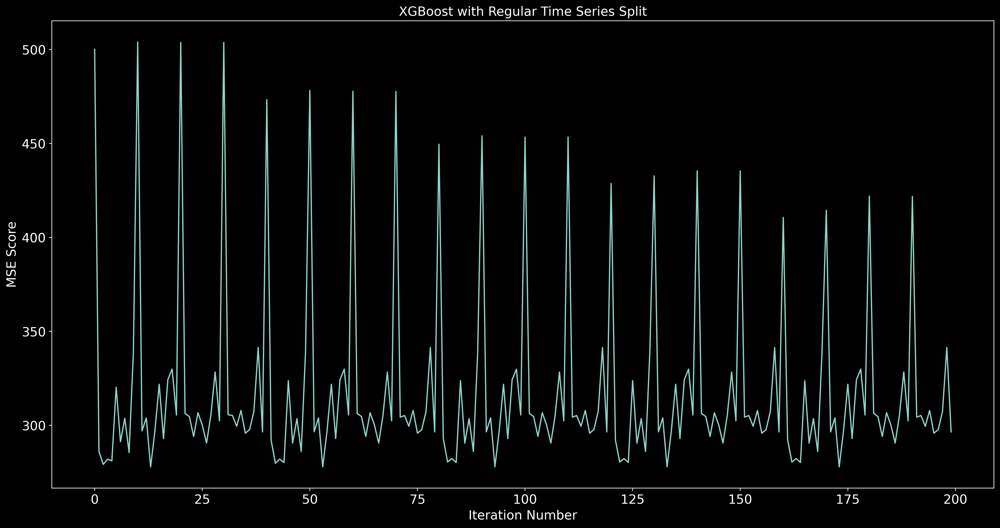

In [117]:
plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
plt.xlabel('Iteration Number', fontsize = 15)
plt.ylabel('MSE Score', fontsize = 15)
plt.xticks(fontsize=15, color = 'white')
plt.yticks(fontsize=15, color = 'white')
plt.title('XGBoost with Regular Time Series Split', fontsize=15, color='white')
scores_df_rtts = pd.DataFrame(scores)
scores_df_rtts.columns = ['i','ne','md', 'lr','scores']
plt.plot(scores_df_rtts['scores'])
plt.show()

In [118]:
best_params_method2_rtts = scores_df_rtts.sort_values(by=['scores']).reset_index()
best_params_method2_rtts = best_params_method2_rtts.iloc[0]
best_params_method2_rtts

index      13.000000
i           4.000000
ne         50.000000
md          6.000000
lr          0.334000
scores    277.912017
Name: 0, dtype: float64

In [119]:
scores = best_params_method2_rtts['scores']
print(f'MSE of XGBoost using Iterative Method and Train Test Split: {scores}')

MSE of XGBoost using Iterative Method and Train Test Split: 277.9120170807628


### RANDOM FOREST REGRESSOR WITH REGULAR TRAIN TEST SPLIT (NO CROSS VALIDATION)

In [120]:
scores = []
score = []

#Grid Search    
for ne in np.linspace(50,1000, 10):
    for md in [1, 2, 3]:
             for mss in [2, 3, 4]:               

                rfr = RandomForestRegressor(   
                    criterion='squared_error',
                    min_samples_split=int(mss),
                    max_depth=md,
                    n_estimators=int(ne),
                    ) 

                rfr.fit(X_train, y_train)         
                y_pred = rfr.predict(X_test)
                score = np.sqrt(mean_squared_error(y_test, y_pred))
                scores.append([i, 
                               int(ne),
                               md,
                               int(mss),
                               score])                
i += 1
print('Grid Search Completed')

Grid Search Completed


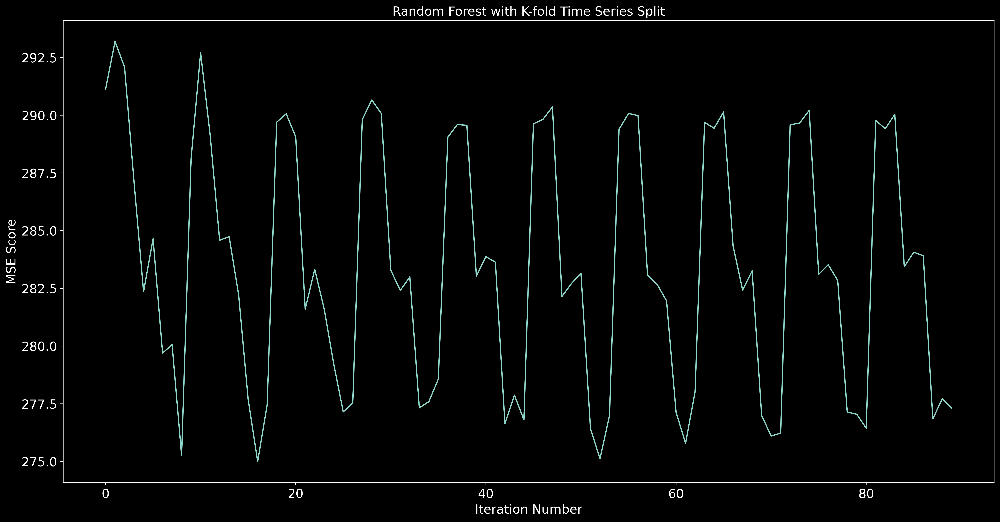

In [121]:
plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
plt.xlabel('Iteration Number', fontsize = 15)
plt.ylabel('MSE Score', fontsize = 15)
plt.xticks(fontsize=15, color = 'white')
plt.yticks(fontsize=15, color = 'white')
plt.title('Random Forest with K-fold Time Series Split', fontsize=15, color='white')
scores_rfr_rtts = pd.DataFrame(scores)
scores_rfr_rtts.columns = ['i','ne', 'md', 'mss','scores']
plt.plot(scores_rfr_rtts['scores'])
plt.show()

In [122]:
best_params_rfr_rtts = scores_rfr_rtts.sort_values(by=['scores']).reset_index()
best_params_rfr_rtts = best_params_rfr_rtts.iloc[0]
best_params_rfr_rtts

index      16.000000
i           4.000000
ne        155.000000
md          3.000000
mss         3.000000
scores    274.994972
Name: 0, dtype: float64

In [123]:
scores = best_params_rfr_rtts['scores']
print(f'MSE of Random Forest using Iterative Method and Regular Time Series Split: {scores}')

MSE of Random Forest using Iterative Method and Regular Time Series Split: 274.9949716257869


### RANDOM FOREST REGRESSION WITH K-FOLD TIME SERIES SPLIT

In [124]:
i=0
fold = 0
preds = []
scores = []
for train_idx, val_idx in tss.split(dfm1):
    train = dfm1.iloc[train_idx]
    test = dfm1.iloc[val_idx]  
    X_train = train[FEATURES]
    y_train = train[TARGET]    
    X_test = test[FEATURES]
    y_test = test[TARGET]  
#Grid Search    
    for ne in np.linspace(50,1000, 10):
        for md in [1, 2, 3]:                                    
                 for mss in [2, 3, 4]:
                    # pre-processing
                    scaler = StandardScaler()
                    # train data 
                    X_train = scaler.fit_transform(X_train)
                    # test data 
                    X_test = scaler.transform(X_test) 
                    X_train = pd.DataFrame(X_train)
                    X_train.columns = features['features']
                    X_test= pd.DataFrame(X_test)
                    X_test.columns = features['features']

                    rfr = RandomForestRegressor(criterion='squared_error',
                    min_samples_split=int(mss),
                    max_depth=md,
                    n_estimators=int(ne),
                    bootstrap=True
                    )

                    rfr.fit(X_train, y_train)         
                    y_pred = rfr.predict(X_test)
                    score = np.sqrt(mean_squared_error(y_test, y_pred))
                    scores.append([i, 
                                   int(ne),
                                   md,
                                   int(mss),
                                   score])                
    i += 1
print('Grid Search Completed')

Grid Search Completed


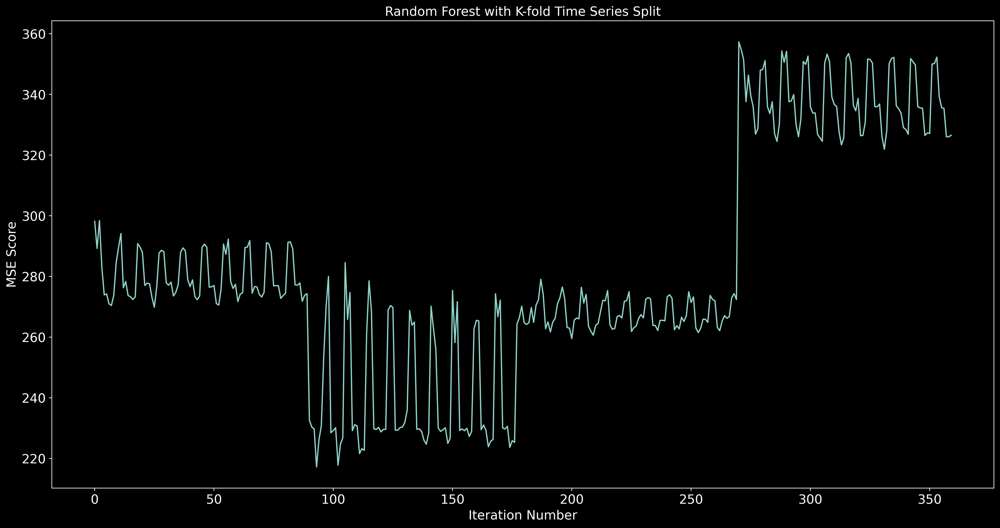

In [125]:

plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
plt.xlabel('Iteration Number', fontsize = 15)
plt.ylabel('MSE Score', fontsize = 15)
plt.xticks(fontsize=15, color = 'white')
plt.yticks(fontsize=15, color = 'white')
plt.title('Random Forest with K-fold Time Series Split', fontsize=15, color='white')
scores_rfr = pd.DataFrame(scores)
scores_rfr.columns = ['i','ne', 'md', 'mss','scores']
plt.plot(scores_rfr['scores'])
plt.show()

In [126]:
best_params_rfr = scores_rfr.sort_values(by=['scores']).reset_index()
best_params_rfr = best_params_rfr.iloc[0]
best_params_rfr

index      93.00000
i           1.00000
ne         50.00000
md          2.00000
mss         2.00000
scores    217.24874
Name: 0, dtype: float64

In [127]:
scores = best_params_rfr['scores']
print(f'MSE of Random Forest using Iterative Method and K-fold Time Series Split: {scores}')

MSE of Random Forest using Iterative Method and K-fold Time Series Split: 217.24874006309918


### RANDOM FOREST REGRESSION WITH BLOCKING TIME SERIES SPLIT

In [128]:
i=0
fold = 0
preds = []
scores = []
for train_idx, val_idx in tss.split(dfm1):
    train = dfm1.iloc[train_idx]
    test = dfm1.iloc[val_idx]  
    X_train = train[FEATURES]
    y_train = train[TARGET]    
    X_test = test[FEATURES]
    y_test = test[TARGET]  
#Grid Search    
    for ne in np.linspace(50,1000, 10):
        for md in [1, 2, 3]:                                    
                 for mss in [2, 3, 4]:
                    # pre-processing
                    scaler = StandardScaler()
                    # train data 
                    X_train = scaler.fit_transform(X_train)
                    # test data 
                    X_test = scaler.transform(X_test) 
                    X_train = pd.DataFrame(X_train)
                    X_train.columns = features['features']
                    X_test= pd.DataFrame(X_test)
                    X_test.columns = features['features']

                    rfr = RandomForestRegressor(criterion='squared_error',
                    min_samples_split=int(mss),
                    max_depth=md,
                    n_estimators=int(ne),
                    bootstrap=True
                    )

                    rfr.fit(X_train, y_train)         
                    y_pred = rfr.predict(X_test)
                    score = np.sqrt(mean_squared_error(y_test, y_pred))
                    scores.append([i, 
                                   int(ne),
                                   md,
                                   int(mss),
                                   score])                
    i += 1
print('Grid Search Completed')

Grid Search Completed


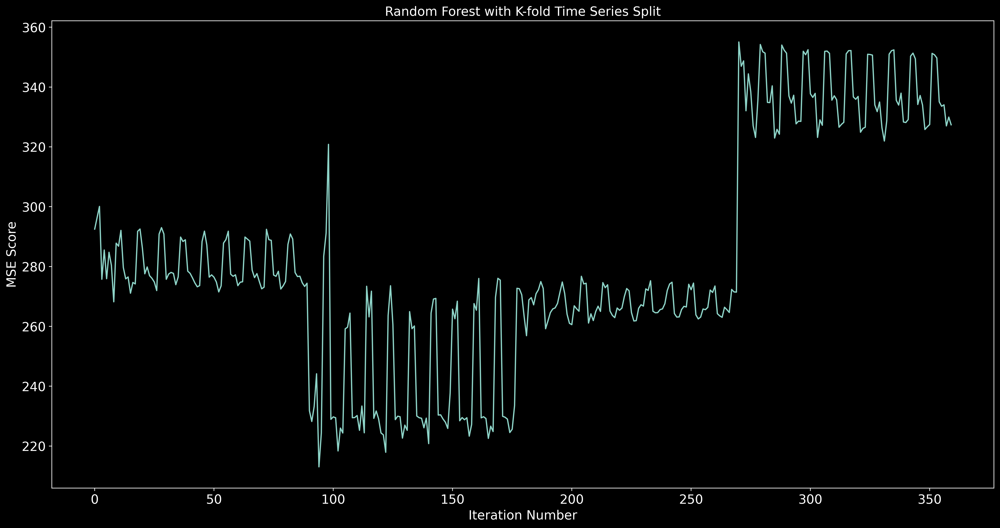

In [129]:
plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
plt.xlabel('Iteration Number', fontsize = 15)
plt.ylabel('MSE Score', fontsize = 15)
plt.xticks(fontsize=15, color = 'white')
plt.yticks(fontsize=15, color = 'white')
plt.title('Random Forest with K-fold Time Series Split', fontsize=15, color='white')
scores_rfr_btscv = pd.DataFrame(scores)
scores_rfr_btscv.columns = ['i','ne', 'md', 'mss','scores']
plt.plot(scores_rfr_btscv['scores'])
plt.show()

In [130]:
best_params_rfr_btscv = scores_rfr_btscv.sort_values(by=['scores']).reset_index()
best_params_rfr_btscv = best_params_rfr_btscv.iloc[0]
best_params_rfr_btscv

index      94.000000
i           1.000000
ne         50.000000
md          2.000000
mss         3.000000
scores    213.051496
Name: 0, dtype: float64

In [131]:
scores = best_params_rfr_btscv['scores']
print(f'MSE of Random Forest using Iterative Method and Blocking Time Series Split: {scores}')

MSE of Random Forest using Iterative Method and Blocking Time Series Split: 213.05149649873607


### ELASTIC NET WITH REGULAR TRAIN TEST SPLIT (NO CROSS VALIDATION)

In [132]:
X_train = train[FEATURES]
y_train = train[TARGET]    
X_test = test[FEATURES]
y_test = test[TARGET]  

scores = []
score = []

elasticnet_alpha= [0.1, 0.3, 0.5, 0.7, 0.9]#
elasticnet_l1ratio = [0.1, 0.3, 0.5, 0.7, 0.9] 
    
for ena in elasticnet_alpha:
     for enl1r in elasticnet_l1ratio:

            # pre-processing
                scaler = StandardScaler()
                # train data 
                X_train = scaler.fit_transform(X_train)
                # test data 
                X_test = scaler.transform(X_test)
                X_train = pd.DataFrame(X_train)
                X_train.columns = features['features']
                X_test= pd.DataFrame(X_test)
                X_test.columns = features['features']

                elasticnet = ElasticNet(
                                        alpha=ena,
                                        l1_ratio=enl1r
                                    )        
                elasticnet.fit(X_train, y_train)

                y_pred = elasticnet.predict(X_test)
                score = np.sqrt(mean_squared_error(y_test, y_pred))
                scores.append([i, 
                               ena,
                               enl1r,
                               score])                
i += 1
print('Grid Search Completed')

Grid Search Completed


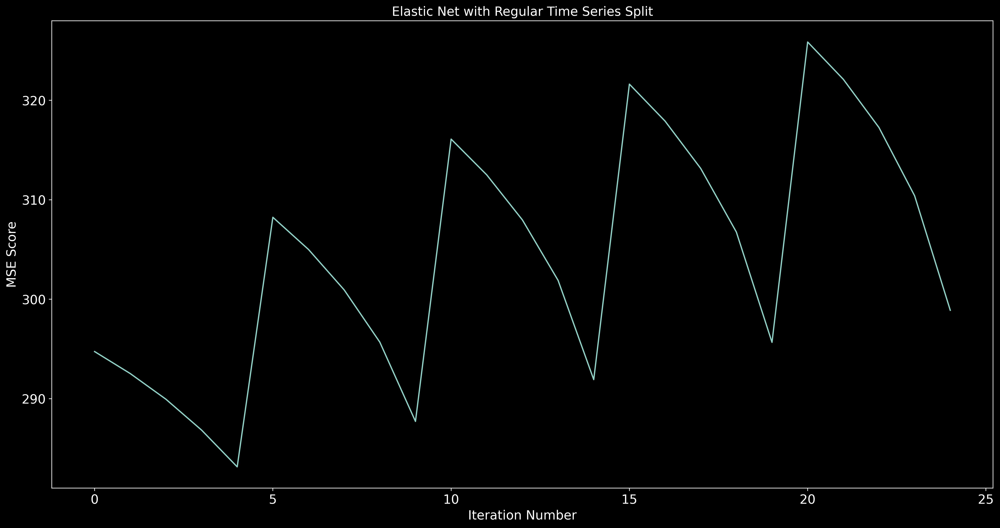

In [133]:

plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
plt.xlabel('Iteration Number', fontsize = 15)
plt.ylabel('MSE Score', fontsize = 15)
plt.xticks(fontsize=15, color = 'white')
plt.yticks(fontsize=15, color = 'white')
plt.title('Elastic Net with Regular Time Series Split', fontsize=15, color='white')
scores_elasticnet_rtts = pd.DataFrame(scores)
scores_elasticnet_rtts.columns = ['i','ena','enl1r', 'scores']
plt.plot(scores_elasticnet_rtts['scores'])
plt.show()

In [134]:
best_params_elasticnet_rtts = scores_elasticnet_rtts.sort_values(by=['scores']).reset_index()
best_params_elasticnet_rtts = best_params_elasticnet_rtts.iloc[0]
best_params_elasticnet_rtts

index       4.00000
i           4.00000
ena         0.10000
enl1r       0.90000
scores    283.14906
Name: 0, dtype: float64

In [135]:
scores = best_params_elasticnet_rtts['scores']
print(f'MSE of Elastic Net using Iterative Method and Regular Time Series Split: {scores}')

MSE of Elastic Net using Iterative Method and Regular Time Series Split: 283.14906020459694


### ELASTIC NET WITH K-FOLD TIME SERIES SPLIT

In [136]:
i=0
fold = 0
preds = []
scores = []

elasticnet_alpha= [0.1, 0.3, 0.5, 0.7, 0.9]
elasticnet_l1ratio = [0.1, 0.3, 0.5, 0.7, 0.9] 

for train_idx, val_idx in tss.split(dfm1):
    train = dfm1.iloc[train_idx]
    test = dfm1.iloc[val_idx]  
    X_train = train[FEATURES]
    y_train = train[TARGET]    
    X_test = test[FEATURES]
    y_test = test[TARGET]  
    
#Grid Search    
    for ena in elasticnet_alpha:
         for enl1r in elasticnet_l1ratio:
                 
                # pre-processing
                    scaler = StandardScaler()
                    # train data 
                    X_train = scaler.fit_transform(X_train)
                    # test data 
                    X_test = scaler.transform(X_test) 
                    X_train = pd.DataFrame(X_train)
                    X_train.columns = features['features']
                    X_test= pd.DataFrame(X_test)
                    X_test.columns = features['features']

                    elasticnet = ElasticNet(alpha=ena,
                                            l1_ratio=enl1r
                                        )        
                    elasticnet.fit(X_train, y_train)

                    y_pred = elasticnet.predict(X_test)
                    score = np.sqrt(mean_squared_error(y_test, y_pred))
                    scores.append([i, 
                                   ena,
                                   enl1r,
                                   score])                
    i += 1
    print('Grid Search Completed')

Grid Search Completed
Grid Search Completed
Grid Search Completed
Grid Search Completed


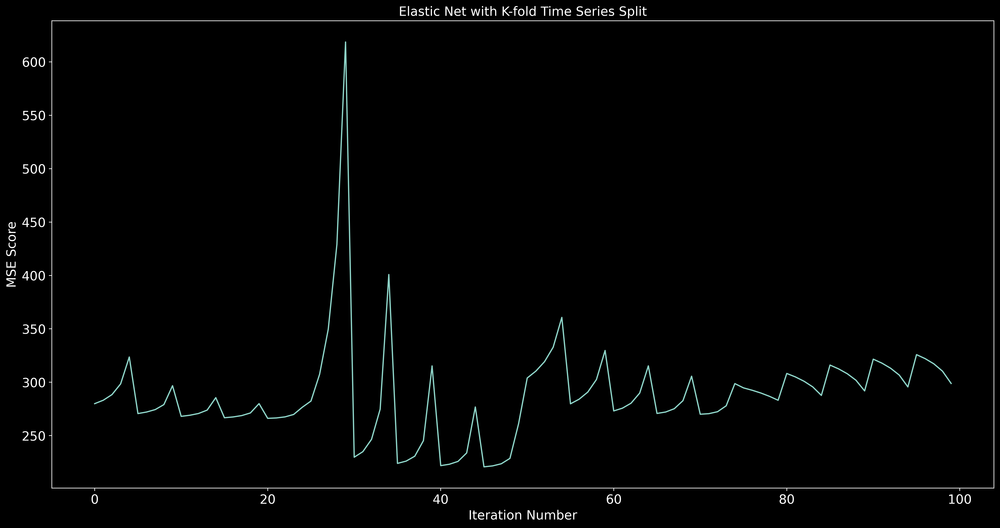

In [137]:

plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
plt.xlabel('Iteration Number', fontsize = 15)
plt.ylabel('MSE Score', fontsize = 15)
plt.xticks(fontsize=15, color = 'white')
plt.yticks(fontsize=15, color = 'white')
plt.title('Elastic Net with K-fold Time Series Split', fontsize=15, color='white')
scores_elasticnet = pd.DataFrame(scores)
scores_elasticnet.columns = ['i','ena','enl1r', 'scores']
plt.plot(scores_elasticnet['scores'])
plt.show()


In [138]:
best_params_elasticnet = scores_elasticnet.sort_values(by=['scores']).reset_index()
best_params_elasticnet = best_params_elasticnet.iloc[0]
best_params_elasticnet

index      45.000000
i           1.000000
ena         0.900000
enl1r       0.100000
scores    220.817354
Name: 0, dtype: float64

In [139]:
scores = best_params_elasticnet['scores']
print(f'MSE of Elastic Net using Iterative Method and K-fold Time Series Split: {scores}')

MSE of Elastic Net using Iterative Method and K-fold Time Series Split: 220.81735435877582


### ELASTIC NET WITH BLOCKING TIME SERIES SPLIT

In [140]:
i=0
fold = 0
preds = []
scores = []

elasticnet_alpha= [0.1, 0.3, 0.5, 0.7, 0.9]
elasticnet_l1ratio = [0.1, 0.3, 0.5, 0.7, 0.9] 

for train_idx, val_idx in btscv.split(dfm1):
    train = dfm1.iloc[train_idx]
    test = dfm1.iloc[val_idx]  
    X_train = train[FEATURES]
    y_train = train[TARGET]    
    X_test = test[FEATURES]
    y_test = test[TARGET]  
    
#Grid Search    
    for ena in elasticnet_alpha:
         for enl1r in elasticnet_l1ratio:
                 
                # pre-processing
                    scaler = StandardScaler()
                    # train data 
                    X_train = scaler.fit_transform(X_train)
                    # test data 
                    X_test = scaler.transform(X_test) 
                    X_train = pd.DataFrame(X_train)
                    X_train.columns = features['features']
                    X_test= pd.DataFrame(X_test)
                    X_test.columns = features['features']

                    elasticnet = ElasticNet(alpha=ena,
                                            l1_ratio=enl1r
                                        )        
                    elasticnet.fit(X_train, y_train)

                    y_pred = elasticnet.predict(X_test)
                    score = np.sqrt(mean_squared_error(y_test, y_pred))
                    scores.append([i, 
                                   ena,
                                   enl1r,
                                   score])                
    i += 1
    print('Grid Search Completed')

Grid Search Completed
Grid Search Completed
Grid Search Completed
Grid Search Completed


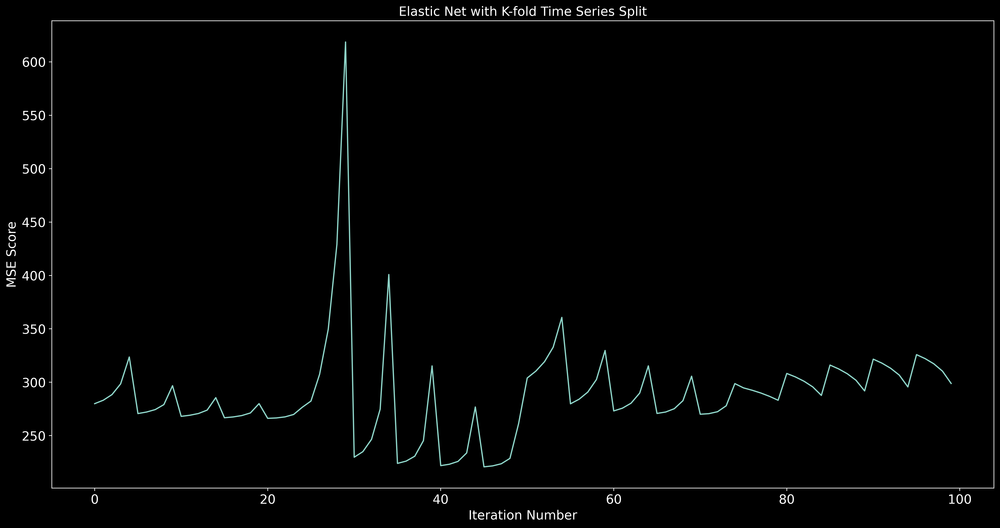

In [141]:

plt.rcParams['figure.figsize'] = [20, 10]
fig = plt.figure(dpi=400)
plt.xlabel('Iteration Number', fontsize = 15)
plt.ylabel('MSE Score', fontsize = 15)
plt.xticks(fontsize=15, color = 'white')
plt.yticks(fontsize=15, color = 'white')
plt.title('Elastic Net with K-fold Time Series Split', fontsize=15, color='white')
scores_elasticnet_btscv = pd.DataFrame(scores)
scores_elasticnet_btscv.columns = ['i','ena','enl1r', 'scores']
plt.plot(scores_elasticnet['scores'])
plt.show()


In [142]:
best_params_elasticnet_btscv = scores_elasticnet_btscv.sort_values(by=['scores']).reset_index()
best_params_elasticnet_btscv = best_params_elasticnet_btscv.iloc[0]
best_params_elasticnet_btscv

index       4.0000
i           0.0000
ena         0.1000
enl1r       0.9000
scores    169.0772
Name: 0, dtype: float64

In [143]:
scores = best_params_elasticnet_btscv['scores']
print(f'MSE of Elastic Net using Iterative Method and Blocking Time Series Split: {scores}')

MSE of Elastic Net using Iterative Method and Blocking Time Series Split: 169.077200474049


## **TRAIN THE MODEL WITH BEST PARAMS FROM CROSS VALIDATION**

In [144]:
split=0.25 
train = dfm1[:-(round(len(X)*split))]
test = dfm1[-(round(len(X)*split)):]

X_train = train[FEATURES]
y_train = train[TARGET]    
X_test = test[FEATURES]
y_test = test[TARGET]

X_complete = scaler.transform(dfm1[FEATURES])
y_complete = np.array(dfm1[TARGET])
y_complete = y_complete.reshape(-1,1)

In [145]:
# pre-processing
scaler = StandardScaler()
# train data 
X_train = scaler.fit_transform(X_train)
# test data 
X_test = scaler.transform(X_test)
# All
X_complete = scaler.transform(dfm1[FEATURES])

In [146]:
X_train = pd.DataFrame(X_train)
X_train.columns = features['features']

In [147]:
X_test= pd.DataFrame(X_test)
X_test.columns = features['features']

## **FITTING MODELS WITH BEST PARAMETERS**

In [148]:
### XGBoost 
regr = xgb.XGBRegressor(booster='gbtree',    
                    n_estimators=int(best_params_method2.loc['ne']),
                    objective='reg:squarederror',
                    max_depth=int(best_params_method2.loc['md']),
                    learning_rate=best_params_method2.loc['lr'])

regr.fit(X_train, y_train,
        eval_set=[(X_train, y_train), (X_test, y_test)],
        verbose=False)

regr_rtts = xgb.XGBRegressor(booster='gbtree',    
                    n_estimators=int(best_params_method2_rtts.loc['ne']),
                    objective='reg:squarederror',
                    max_depth=int(best_params_method2_rtts.loc['md']),
                    learning_rate=best_params_method2_rtts.loc['lr'])

regr_rtts.fit(X_train, y_train,
        eval_set=[(X_train, y_train), (X_test, y_test)],
        verbose=False)

### Random Forest 

rfr = RandomForestRegressor(criterion='squared_error',
                min_samples_split=int(best_params_rfr.loc['mss']),
                max_depth=int(best_params_rfr.loc['md']),
                n_estimators=int(best_params_rfr.loc['ne']),
                ) 

rfr.fit(X_train, y_train)

rfr_rtts = RandomForestRegressor(criterion='squared_error', 
                    max_depth=int(best_params_rfr_rtts.loc['md']),
                    min_samples_split=int(best_params_rfr_rtts.loc['mss']),
                    n_estimators=int(best_params_rfr_rtts.loc['ne'])
                    ) 

rfr_rtts.fit(X_train, y_train)

### Elastic Net

elasticnet = ElasticNet(alpha = best_params_elasticnet.loc['ena'],
                        l1_ratio = best_params_elasticnet.loc['enl1r']

                )        

elasticnet.fit(X_train, y_train)

elasticnet_rtts = ElasticNet(alpha = best_params_elasticnet_rtts.loc['ena'],
                            l1_ratio=best_params_elasticnet_rtts.loc['enl1r']

            )        

elasticnet_rtts.fit(X_train, y_train)

##change all rtts from elastic and xgb to btscv

ElasticNet(alpha=0.1, l1_ratio=0.9)

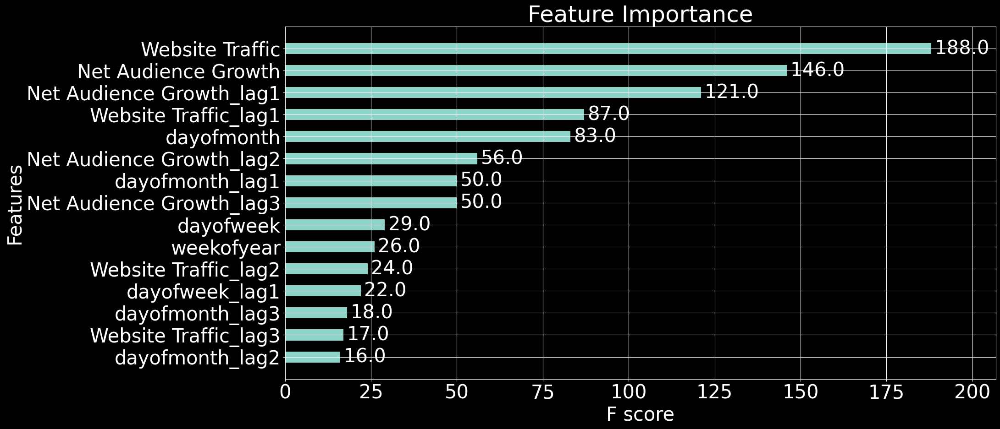

In [149]:
feature_names = FEATURES.to_list()
regr.get_booster().feature_names = feature_names
xgb.plot_importance(regr, height=0.5, max_num_features = 15)

plt.title('Feature Importance', color='white')
plt.show()

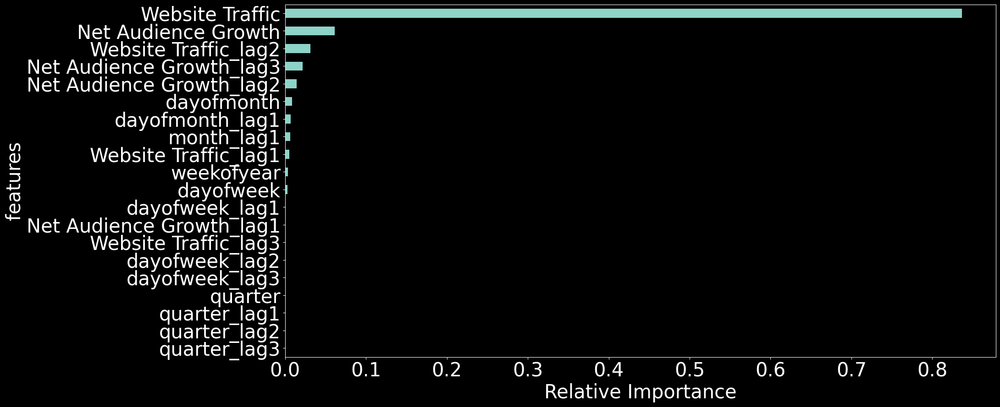

In [150]:
feat_importances = pd.Series(rfr.feature_importances_, index=FEATURES)
feat_importances.nlargest(20).plot(kind='barh').invert_yaxis()
plt.xlabel('Relative Importance')
plt.show()

In [151]:
pred_xgb = regr.predict(X_test)
pred_xgb = np.round(pred_xgb)

pred_xgb_rtts = regr_rtts.predict(X_test)
pred_xgb_rtts = np.round(pred_xgb_rtts)

pred_rfr = rfr.predict(X_test)
pred_rfr= np.round(pred_rfr)

pred_rfr_rtts = rfr_rtts.predict(X_test)
pred_rfr_rtts= np.round(pred_rfr_rtts)

pred_elasticnet = elasticnet.predict(X_test)
pred_elasticnet= np.round(pred_elasticnet)

pred_elasticnet_rtts = elasticnet_rtts.predict(X_test)
pred_elasticnet_rtts = np.round(pred_elasticnet_rtts)

In [152]:
model1 = {'y_test': y_test, 'pred_xgb': pred_xgb}
model1 = pd.DataFrame(model1)

model2 = {'y_test': y_test, 'pred_rfr': pred_rfr}
model2 = pd.DataFrame(model2)

model3 = {'y_test': y_test, 'pred_elasticnet': pred_elasticnet}
model3 = pd.DataFrame(model3)

In [153]:
model1_rtts = {'y_test': y_test, 'pred_xgb': pred_xgb_rtts}
model1_rtts = pd.DataFrame(model1_rtts)

model2_rtts = {'y_test': y_test, 'pred_rfr': pred_rfr_rtts}
model2_rtts = pd.DataFrame(model2_rtts)

model3_rtts = {'y_test': y_test, 'pred_elasticnet': pred_elasticnet_rtts}
model3_rtts = pd.DataFrame(model3_rtts)

In [154]:
y_test = np.array(y_test)
y_test = y_test.reshape(-1,1)

In [155]:
score1 = np.sqrt(mean_squared_error(model1['y_test'], model1['pred_xgb']))
print('XGBoost Model RMSE: {}'.format(score1.round(2)))
score1_rtts = np.sqrt(mean_squared_error(model1_rtts['y_test'], model1_rtts['pred_xgb']))
print('XGBoost_rtts Model RMSE: {}'.format(score1_rtts.round(2)))
score2 = np.sqrt(mean_squared_error(model2['y_test'], model2['pred_rfr']))
print('Random Forest Model RMSE: {}'.format(score2.round(2)))
score2_rtts = np.sqrt(mean_squared_error(model2_rtts['y_test'], model2_rtts['pred_rfr']))
print('Random Forest_rtts Model RMSE: {}'.format(score2_rtts.round(2)))
score3 = np.sqrt(mean_squared_error(model3['y_test'], model3['pred_elasticnet']))
print('Elastic Net Model RMSE: {}'.format(score3.round(2)))
score3_rtts = np.sqrt(mean_squared_error(model3_rtts['y_test'], model3_rtts['pred_elasticnet']))
print('Elastic Net_rtts Model RMSE: {}'.format(score3_rtts.round(2)))

XGBoost Model RMSE: 292.09
XGBoost_rtts Model RMSE: 277.87
Random Forest Model RMSE: 282.41
Random Forest_rtts Model RMSE: 279.05
Elastic Net Model RMSE: 276.19
Elastic Net_rtts Model RMSE: 1354.27


<Figure size 24000x12000 with 0 Axes>

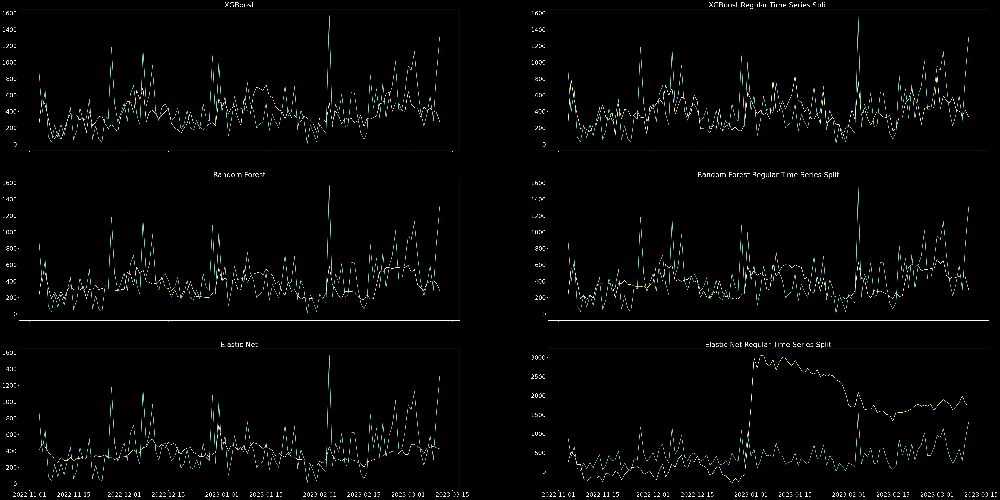

In [156]:
plt.rcParams['figure.figsize'] = [60, 30]
plt.rcParams["font.size"] = 20;
fig = plt.figure(dpi=400)
fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6)) = plt.subplots(3,2, sharex = True)

ax1.set_title('XGBoost')
ax1.plot(model1)
ax2.set_title('XGBoost Regular Time Series Split')
ax2.plot(model1_rtts)
ax3.set_title('Random Forest')
ax3.plot(model2)
ax4.set_title('Random Forest Regular Time Series Split')
ax4.plot(model2_rtts)
ax5.set_title('Elastic Net')
ax5.plot(model3)
ax6.set_title('Elastic Net Regular Time Series Split')
ax6.plot(model3_rtts)

# **USING COMPLETE DATASET FOR FITTING PREDICTIVE MODEL TO BE USED WITH STREAMLIT**

In [157]:
train = dfm1[:-(round(len(X)*split))]
test = dfm1[-(round(len(X)*split)):]

X_train = train[FEATURES]
y_train = train[TARGET]

X_test = test[FEATURES]
y_test = test[TARGET]

y_complete = np.array(dfm1[TARGET])
y_complete = y_complete.reshape(-1,1)

In [158]:
# train data 
X_train = scaler.fit_transform(X_train)
# test data 
X_test = scaler.transform(X_test)
# All
X_complete = scaler.transform(dfm1[FEATURES])

### **FIT ON REGULAR TIME SERIES SPLIT (RTTS)**

In [159]:
regr_rtts.fit(X_complete, y_complete,
         eval_set=[(X_train, y_train), (X_test, y_test)],
         verbose=False)

pred_complete_xgb_rtts = regr_rtts.predict(X_complete)
pred_complete_xgb_rtts = np.round(pred_complete_xgb_rtts)
pred_complete_xgb_rtts.size

rfr_rtts.fit(X_complete, y_complete)
pred_complete_rfr_rtts = rfr_rtts.predict(X_complete)
pred_complete_rfr_rtts = np.round(pred_complete_rfr_rtts)
pred_complete_rfr_rtts.size

elasticnet_rtts.fit(X_complete, y_complete)
pred_complete_elasticnet_rtts = elasticnet_rtts.predict(X_complete)
pred_complete_elasticnet_rtts = np.round(pred_complete_elasticnet_rtts)
pred_complete_elasticnet_rtts.size

270

### **FIT ON K-FOLD TIME SERIES SPLIT (RTTS)**

In [160]:
regr.fit(X_complete, y_complete,
         eval_set=[(X_train, y_train), (X_test, y_test)],
         verbose=False)

pred_complete_xgb = regr.predict(X_complete)
pred_complete_xgb = np.round(pred_complete_xgb)
pred_complete_xgb.size

rfr.fit(X_complete, y_complete)
pred_complete_rfr = rfr.predict(X_complete)
pred_complete_rfr = np.round(pred_complete_rfr)
pred_complete_rfr.size

elasticnet.fit(X_complete, y_complete)
pred_complete_elasticnet = elasticnet.predict(X_complete)
pred_complete_elasticnet = np.round(pred_complete_elasticnet)
pred_complete_elasticnet.size

270

#### ADDING ENSEMBLE OF MODELS

In [161]:
score_ensemble = pd.DataFrame()
scores_ensemble = []

models = [('XGBoost', regr), 
          ('Random Forest',rfr),
          ('ElasticNet', elasticnet)
         ]

for name, model in models:
    
    prediction = model.predict(X_test)
    score_ensemble = mean_squared_error(y_test, prediction, squared = False)
    scores_ensemble.append(score_ensemble)
    print('{} Model RMSE: {}'.format(name, score_ensemble))

XGBoost Model RMSE: 77.61194455460969
Random Forest Model RMSE: 257.3461743182078
ElasticNet Model RMSE: 253.8499921695004


In [162]:
scores_ensemble = [-x for x in scores_ensemble]
ranking = 1 + np.argsort(scores_ensemble)
print(ranking)

ranking_csv = pd.DataFrame(ranking)
ranking_csv.to_csv('ranking.csv')

[2 3 1]


In [163]:
ensemble = VotingRegressor(estimators=models, weights = ranking)

ensemble.fit(X_train, y_train)
prediction = ensemble.predict(X_test)
score_ensemble = mean_squared_error(y_test, prediction, squared = False)
print('Ensemble Model RMSE: {}'.format(score_ensemble))

Ensemble Model RMSE: 279.5363159320108


In [164]:
train_complete_ensemble = ensemble.fit(X_complete, y_complete)
pred_complete_ensemble = ensemble.predict(X_complete)

In [165]:
score_ensemble_rtts = []
scores_ensemble_rtts = []

models = [
          ('XGBoost_rtts', regr_rtts), 
          ('Random Forest_rtts',rfr_rtts),
          ('ElasticNet_rtts', elasticnet_rtts),
         ]

for name, model in models:
    
    prediction_rtts = model.predict(X_test)
    score_ensemble_rtts = mean_squared_error(y_test, prediction_rtts, squared = False)
    scores_ensemble_rtts.append(score_ensemble_rtts)
    print('{} Model RMSE: {}'.format(name, score_ensemble_rtts))

XGBoost_rtts Model RMSE: 4.854002529957821
Random Forest_rtts Model RMSE: 227.45397012506692
ElasticNet_rtts Model RMSE: 236.21380827148562


In [166]:
scores_ensemble_rtts = [-x for x in scores_ensemble_rtts]
ranking_rtts = 1 + np.argsort(scores_ensemble_rtts)
print(ranking_rtts)

[3 2 1]


In [167]:
ensemble_rtts = VotingRegressor(estimators=models, weights = ranking)
ensemble_rtts.fit(X_train, y_train)
prediction_rtts = ensemble_rtts.predict(X_test)
score_ensemble_rtts = mean_squared_error(y_test, prediction_rtts, squared = False)
print('Ensemble Model RMSE: {}'.format(score_ensemble_rtts.round(2)))

Ensemble Model RMSE: 344.02


In [168]:
train_complete_ensemble_rtts = ensemble_rtts.fit(X_complete, y_complete)
pred_complete_ensemble_rtts = ensemble_rtts.predict(X_complete)

In [169]:
dfm1['pred_xgb'] = pred_complete_xgb
dfm1['pred_xgb_rtts'] = pred_complete_xgb_rtts
dfm1['pred_rfr'] = pred_complete_rfr
dfm1['pred_rfr_rtts'] = pred_complete_rfr_rtts
dfm1['pred_elasticnet'] = pred_complete_elasticnet
dfm1['pred_elasticnet_rtts'] = pred_complete_elasticnet_rtts
dfm1['pred_ensemble'] = pred_complete_ensemble
dfm1['pred_ensemble_rtts'] = pred_complete_ensemble_rtts

<Figure size 24000x6000 with 0 Axes>

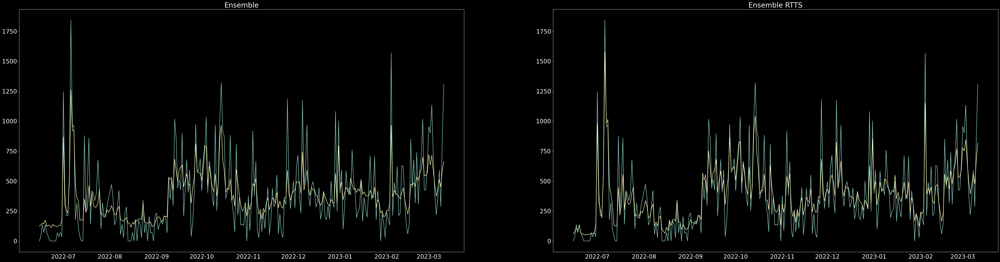

In [170]:
plt.rcParams['figure.figsize'] = [60, 15]
plt.rcParams["font.size"] = 20;
fig = plt.figure(dpi=400)

# plt.rcParams['figure.figsize'] = [40, 30]
# fig = plt.figure(dpi=400)

fig, ((ax1, ax2)) = plt.subplots(1,2, sharex = True)

# fig, (ax1, ax2) = plt.subplots(2, sharex = True)
ax1.set_title('Ensemble')
ax1.plot(dfm1['total_price'][:])
ax1.plot(dfm1['pred_ensemble'][:])

ax2.set_title('Ensemble RTTS')
ax2.plot(dfm1['total_price'][:])
ax2.plot(dfm1['pred_ensemble_rtts'][:])

plt.show()

## **FUTURE ANALYSIS**

#### CREATING FUTURE

In [171]:
future = pd.date_range(dfm1.index.max(), dfm1.index.max() + pd.Timedelta(t1))
future_df = pd.DataFrame(index=future)
future_df['isFuture'] = True
df['isFuture'] = False
df_and_future = pd.concat([dfm1,future_df])

In [172]:
def create_features(df_and_future):
    """
    Create time series features based on time series index.
    """
    df_and_future = df_and_future.copy()
    df_and_future['hour'] = df_and_future.index.hour
    df_and_future['dayofweek'] = df_and_future.index.dayofweek
    df_and_future['quarter'] = df_and_future.index.quarter
    df_and_future['month'] = df_and_future.index.month
    df_and_future['year'] = df_and_future.index.year
    df_and_future['dayofyear'] = df_and_future.index.dayofyear
    df_and_future['dayofmonth'] = df_and_future.index.day
    df_and_future['weekofyear'] = df_and_future.index.isocalendar().week
    return df_and_future
df_and_future = create_features(df_and_future)

In [173]:
df_and_future['isFuture'] = df_and_future['isFuture'].isna()
df_and_future['isFuture'] = ~df_and_future['isFuture']

In [174]:
features['features']

0          Net Audience Growth
1     Net Audience Growth_lag1
2     Net Audience Growth_lag2
3     Net Audience Growth_lag3
4              Website Traffic
5         Website Traffic_lag1
6         Website Traffic_lag2
7         Website Traffic_lag3
8                    dayofweek
9               dayofweek_lag1
10              dayofweek_lag2
11              dayofweek_lag3
12                     quarter
13                quarter_lag1
14                quarter_lag2
15                quarter_lag3
16                       month
17                  month_lag1
18                  month_lag2
19                  month_lag3
20                  dayofmonth
21             dayofmonth_lag1
22             dayofmonth_lag2
23             dayofmonth_lag3
24                  weekofyear
25             weekofyear_lag1
26             weekofyear_lag2
27             weekofyear_lag3
Name: features, dtype: object

In [175]:
for i in range(len(features)):
    lagged_feature = features['features'][i]
    target_map = df_and_future[lagged_feature].to_dict()
    df_and_future[f"{lagged_feature}"] = (df_and_future.index - pd.Timedelta(t1)).map(target_map)
    df_and_future[f"{lagged_feature}"] = (df_and_future.index - pd.Timedelta(t2)).map(target_map)
    df_and_future[f"{lagged_feature}"] = (df_and_future.index - pd.Timedelta(t3)).map(target_map)


In [176]:
future_w_features = df_and_future.query('isFuture').copy()

In [177]:
future_w_features =future_w_features[:t1_n]


In [178]:
X_future = scaler.transform(future_w_features[FEATURES])

In [179]:
future_w_features['pred_xgb'] = np.round(regr.predict(X_future))
future_w_features['pred_xgb_rtts'] = np.round(regr_rtts.predict(X_future))

future_w_features['pred_rfr'] = np.round(rfr.predict(X_future))
future_w_features['pred_rfr_rtts'] = np.round(rfr_rtts.predict(X_future))

future_w_features['pred_elasticnet'] = np.round(elasticnet.predict(X_future))
future_w_features['pred_elasticnet_rtts'] = np.round(elasticnet_rtts.predict(X_future))

future_w_features['pred_ensemble'] = np.round(ensemble.predict(X_future))
future_w_features['pred_ensemble_rtts'] = np.round(ensemble_rtts.predict(X_future))

In [180]:
model2_fix = pd.DataFrame()
model2_fix = dfm1['pred_xgb'].append(future_w_features['pred_xgb'])
model2_fix_rtts = pd.DataFrame()
model2_fix_rtts = dfm1['pred_xgb_rtts'].append(future_w_features['pred_xgb_rtts'])

model3_fix = pd.DataFrame()
model3_fix = dfm1['pred_rfr'].append(future_w_features['pred_rfr'])
model3_fix_rtts = pd.DataFrame()
model3_fix_rtts = dfm1['pred_rfr_rtts'].append(future_w_features['pred_rfr_rtts'])

model4_fix = pd.DataFrame()
model4_fix = dfm1['pred_elasticnet'].append(future_w_features['pred_elasticnet'])
model4_fix_rtts = pd.DataFrame()
model4_fix_rtts = dfm1['pred_elasticnet_rtts'].append(future_w_features['pred_elasticnet_rtts'])

model5_fix = pd.DataFrame()
model5_fix = dfm1['pred_ensemble'].append(future_w_features['pred_ensemble'])
model5_fix_rtts = pd.DataFrame()
model5_fix_rtts = dfm1['pred_ensemble_rtts'].append(future_w_features['pred_ensemble_rtts'])

In [181]:
model2_fix

2022-06-15     16.0
2022-06-16     29.0
2022-06-17     83.0
2022-06-18     67.0
2022-06-19    114.0
              ...  
2023-04-05    469.0
2023-04-06    443.0
2023-04-07    402.0
2023-04-08    476.0
2023-04-09    613.0
Name: pred_xgb, Length: 300, dtype: float32

In [182]:
data_with_predictions = pd.DataFrame()

In [183]:
data_with_predictions['actual'] = A['total_price']

In [184]:
data_with_predictions = pd.concat([data_with_predictions,model2_fix], axis=1)
data_with_predictions = pd.concat([data_with_predictions,model2_fix_rtts], axis=1)
data_with_predictions = pd.concat([data_with_predictions,model3_fix], axis=1)
data_with_predictions = pd.concat([data_with_predictions,model3_fix_rtts], axis=1)
data_with_predictions = pd.concat([data_with_predictions,model4_fix], axis=1)
data_with_predictions = pd.concat([data_with_predictions,model4_fix_rtts], axis=1)
data_with_predictions = pd.concat([data_with_predictions,model5_fix], axis=1)
data_with_predictions = pd.concat([data_with_predictions,model5_fix_rtts], axis=1)
data_with_predictions.tail(10)

,actual,pred_xgb,pred_xgb_rtts,pred_rfr,pred_rfr_rtts,pred_elasticnet,pred_elasticnet_rtts,pred_ensemble,pred_ensemble_rtts
2023-03-31,NaN,969.0,1003.0,644.0,712.0,702.0,864.0,795.0,852.0
2023-04-01,NaN,424.0,400.0,453.0,479.0,485.0,412.0,433.0,427.0
2023-04-02,NaN,569.0,593.0,472.0,469.0,469.0,466.0,490.0,499.0
2023-04-03,NaN,197.0,106.0,460.0,429.0,404.0,354.0,344.0,300.0
2023-04-04,NaN,351.0,286.0,460.0,445.0,440.0,414.0,401.0,379.0
2023-04-05,NaN,469.0,580.0,449.0,435.0,456.0,499.0,445.0,490.0
2023-04-06,NaN,443.0,411.0,430.0,446.0,458.0,434.0,432.0,424.0
2023-04-07,NaN,402.0,443.0,364.0,394.0,456.0,431.0,387.0,422.0
2023-04-08,NaN,476.0,383.0,595.0,545.0,471.0,593.0,522.0,517.0
2023-04-09,NaN,613.0,750.0,445.0,427.0,365.0,318.0,475.0,511.0


In [185]:
data_with_predictions.loc['2023-03-03':]

,actual,pred_xgb,pred_xgb_rtts,pred_rfr,pred_rfr_rtts,pred_elasticnet,pred_elasticnet_rtts,pred_ensemble,pred_ensemble_rtts
2023-03-03,1133.0,1007.0,1128.0,578.0,686.0,611.0,788.0,713.297334,845.812071
2023-03-04,707.0,782.0,710.0,484.0,580.0,598.0,722.0,584.452065,648.055901
2023-03-05,386.0,503.0,391.0,459.0,517.0,550.0,670.0,468.935641,499.072263
2023-03-06,218.0,269.0,218.0,448.0,458.0,464.0,484.0,374.345996,393.508673
2023-03-07,370.0,409.0,366.0,463.0,499.0,526.0,597.0,433.672134,470.151564
2023-03-08,590.0,594.0,594.0,473.0,541.0,528.0,600.0,510.093063,561.495695
2023-03-09,288.0,404.0,291.0,473.0,542.0,556.0,704.0,454.254396,477.567431
2023-03-10,862.0,833.0,863.0,469.0,560.0,575.0,675.0,597.846570,674.015150
2023-03-11,1307.0,1037.0,1296.0,454.0,563.0,570.0,656.0,662.802978,818.559952
2023-03-11,1307.0,453.0,401.0,449.0,424.0,450.0,485.0,436.000000,425.000000


In [186]:
df_CAM['total_price'].tail(20)

formatted_date
2023-03-14 01:17:56     74.03
2023-03-14 03:03:01     30.13
2023-03-14 14:15:06     74.03
2023-03-14 17:18:10     74.03
2023-03-14 17:24:34     74.03
2023-03-14 17:27:57     74.03
2023-03-15 13:50:28     30.13
2023-03-15 14:03:27     30.59
2023-03-15 15:13:54     68.99
2023-03-15 21:40:41     70.94
2023-03-15 22:32:19     28.99
2023-03-16 05:30:18    140.03
2023-03-16 11:11:03     68.99
2023-03-16 21:24:22     30.13
2023-03-16 22:32:27     74.03
2023-03-16 22:47:58    144.97
2023-03-17 06:33:45    140.03
2023-03-17 13:58:39     68.99
2023-03-17 16:32:15     74.03
2023-03-17 17:45:29     74.03
Name: total_price, dtype: float64

<Figure size 20000x12000 with 0 Axes>

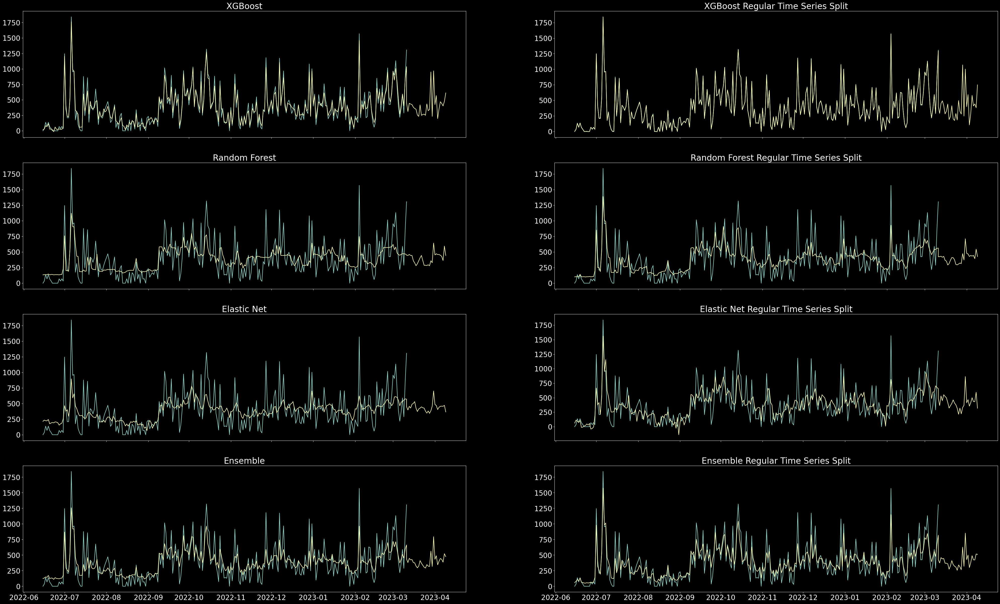

In [187]:
plt.rcParams['figure.figsize'] = [50, 30]
plt.rcParams["font.size"] = 20;
fig = plt.figure(dpi=400)

fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7, ax8)) = plt.subplots(4,2, sharex = True)
ax1.set_title('XGBoost')
ax1.plot(data_with_predictions[['actual','pred_xgb']])
ax2.set_title('XGBoost Regular Time Series Split')
ax2.plot(data_with_predictions[['actual','pred_xgb_rtts']])
ax3.set_title('Random Forest')
ax3.plot(data_with_predictions[['actual','pred_rfr']])
ax4.set_title('Random Forest Regular Time Series Split')
ax4.plot(data_with_predictions[['actual','pred_rfr_rtts']])
ax5.set_title('Elastic Net')
ax5.plot(data_with_predictions[['actual','pred_elasticnet']])
ax6.set_title('Elastic Net Regular Time Series Split')
ax6.plot(data_with_predictions[['actual','pred_elasticnet_rtts']])

ax7.set_title('Ensemble')
ax7.plot(data_with_predictions[['actual','pred_ensemble']])
ax8.set_title('Ensemble Regular Time Series Split')
ax8.plot(data_with_predictions[['actual','pred_ensemble_rtts']])

In [189]:

plt.rcParams['figure.figsize'] = [60, 20]
plt.rcParams["font.size"] = 25;
fig = plt.figure(dpi=400)



plt.xlabel('Date', fontsize = 25)
plt.ylabel('Gross Sales (£)', fontsize = 25)

frequency = 'w'

plt.plot(data_with_predictions.loc['2022-11-02':'2023-03-05'].reset_index().groupby([pd.Grouper(key='index', freq=frequency)])['actual'].sum(),linestyle = '-',marker='o' , color = 'green')
plt.plot(data_with_predictions.loc['2023-02-27':].reset_index().groupby([pd.Grouper(key='index', freq=frequency)])['pred_xgb'].sum(), color = 'blue',linestyle = '--')
plt.plot(data_with_predictions.loc['2023-02-27':].reset_index().groupby([pd.Grouper(key='index', freq=frequency)])['pred_rfr'].sum(), color = 'red',linestyle = '--')
plt.plot(data_with_predictions.loc['2023-02-27':].reset_index().groupby([pd.Grouper(key='index', freq=frequency)])['pred_elasticnet'].sum(), color = 'purple',linestyle = '--')
plt.plot(data_with_predictions.loc['2023-02-27':].reset_index().groupby([pd.Grouper(key='index', freq=frequency)])['pred_ensemble'].sum(), color = 'white',linestyle = '--')

plt.title('Sales Forecast Using Cross Validation for Parameter Estimation')
plt.legend(labels = ['Actual','XGBoost','Random Forest', 'Elastic Net', 'Ensemble'],loc=0, fontsize = 30)
plt.show()

In [190]:
plt.rcParams['figure.figsize'] = [60, 20]
plt.rcParams["font.size"] = 25;
fig = plt.figure(dpi=400)
plt.xlabel('Date', fontsize = 25)
plt.ylabel('Gross Sales (£)', fontsize = 25)

plt.plot(data_with_predictions.loc['2022-6-02':'2023-03-05'].reset_index().groupby([pd.Grouper(key='index', freq=frequency)])['actual'].sum(),linestyle = '-',marker='o', color = 'green')
plt.plot(data_with_predictions.loc['2023-02-27':].reset_index().groupby([pd.Grouper(key='index', freq=frequency)])['pred_xgb_rtts'].sum(), color = 'blue',linestyle = '--')
plt.plot(data_with_predictions.loc['2023-02-27':].reset_index().groupby([pd.Grouper(key='index', freq=frequency)])['pred_rfr_rtts'].sum(), color = 'red',linestyle = '--')
plt.plot(data_with_predictions.loc['2023-02-27':].reset_index().groupby([pd.Grouper(key='index', freq=frequency)])['pred_elasticnet_rtts'].sum(), color = 'purple',linestyle = '--')
plt.plot(data_with_predictions.loc['2023-02-27':].reset_index().groupby([pd.Grouper(key='index', freq=frequency)])['pred_ensemble_rtts'].sum(), color = 'white',linestyle = '--')
plt.legend(labels = ['Actual','XGBoost','Random Forest', 'Elastic Net', 'Ensemble'],loc=0, fontsize = 30)

plt.title('Sales Forecast Using Regular Time Series for Parameter Estimation')
plt.show()

## **SAVING PICKLE FILES AND RELEVANT DATA FOR STREAMLIT APP DEVELOPMENT**

In [191]:
# save the model to disk
filename = 'finalized_XGBoostmodel.sav'
pickle.dump(regr, open(filename, 'wb'))
filename = 'finalized_XGBoostmodel_rtts.sav'
pickle.dump(regr_rtts, open(filename, 'wb'))

filename = 'finalized_RandomForestmodel.sav'
pickle.dump(rfr, open(filename, 'wb'))
filename = 'finalized_RandomForestmodel_rtts.sav'
pickle.dump(rfr_rtts, open(filename, 'wb'))

filename = 'finalized_ElasticNet.sav'
pickle.dump(elasticnet, open(filename, 'wb'))
filename = 'finalized_ElasticNet_rtts.sav'
pickle.dump(elasticnet_rtts, open(filename, 'wb'))


In [192]:
train = dfm1[:-(round(len(X)*split))]
test = dfm1[-(round(len(X)*split)):]

y_complete = dfm1[TARGET]
X_complete = dfm1[FEATURES]

X_complete.to_csv('X_complete.csv')
y_complete.to_csv('y_complete.csv')

In [193]:
X_future = future_w_features[FEATURES]
X_future.to_csv('X_future.csv')

In [194]:
X_past = pd.DataFrame()
X_past['Website Traffic'] = dfm1['Website Traffic']
X_past['Net Audience Growth'] = dfm1['Net Audience Growth']
X_past['dayofweek'] = dfm1['dayofweek']
X_past['quarter'] = dfm1['quarter']
X_past['month'] = dfm1['month']
X_past['dayofmonth'] = dfm1['dayofmonth']
X_past['weekofyear'] = dfm1['weekofyear']

In [195]:
X_past.to_csv('X_past.csv')